# Image Processing CookBook
## Chapter 02
### Author: Sandipan Dey

### Histogram Matching

255 255


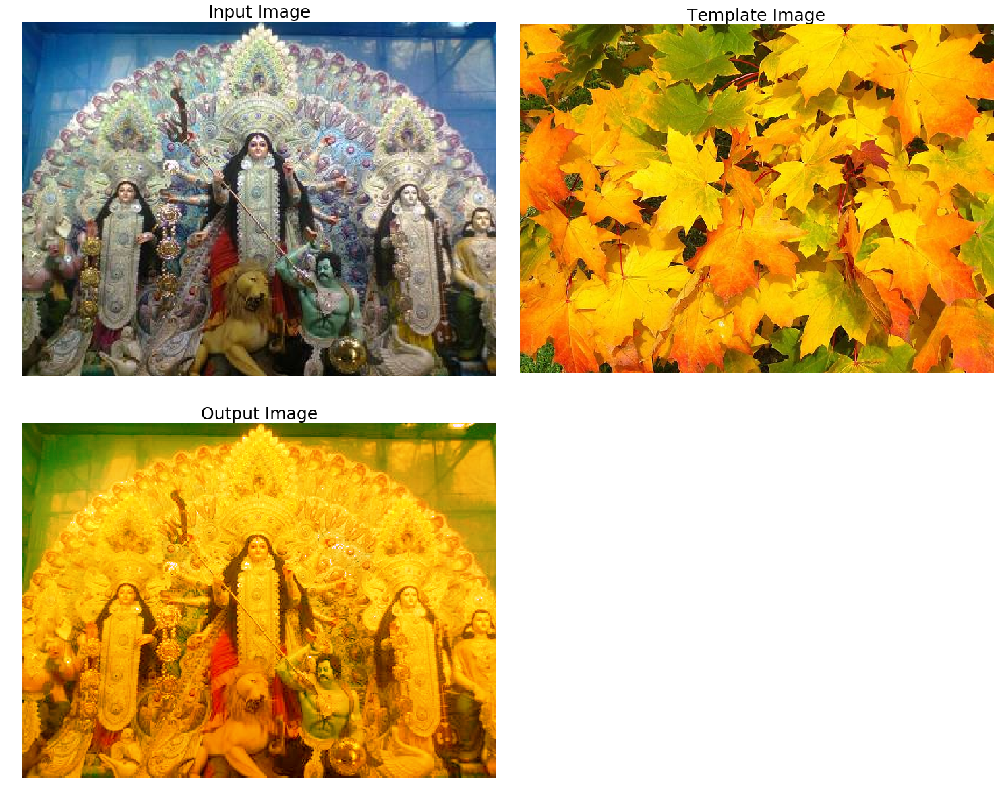

In [23]:
% matplotlib inline
from skimage.exposure import cumulative_distribution
from skimage.io import imread
from skimage.color import rgb2gray
import matplotlib.pylab as plt
import numpy as np

def hist_matching(c, c_t, im):
    b = np.interp(c, c_t, np.arange(256))   # find closest matches to b_t
    pix_repl = {i:b[i] for i in range(256)} # dictionary to replace the pixels
    mp = np.arange(0,256)
    for (k, v) in pix_repl.items():
        mp[k] = v
    s = im.shape
    im = np.reshape(mp[im.ravel()], im.shape)
    im = np.reshape(im, s)
    return im

def cdf(im):
    c, b = cumulative_distribution(im)
    #print(b)
    for i in range(b[0]):
        c = np.insert(c, 0, 0)
    for i in range(b[-1]+1, 256):
        c = np.append(c, 1)
    return c

im = imread('images/goddess.jpg').astype(np.uint8)
im_t = imread('images/leaves.jpg')
print(np.max(im), np.max(im_t))

im1 = np.zeros(im.shape).astype(np.uint8)
for i in range(3):
    c = cdf(im[...,i])
    c_t = cdf(im_t[...,i])
    im1[...,i] = hist_matching(c, c_t, im[...,i])

plt.figure(figsize=(20,17))
plt.subplots_adjust(left=0, top=0.95, right=1, bottom=0, wspace=0.05, hspace=0.05)
plt.subplot(221), plt.imshow(im), plt.axis('off'), plt.title('Input Image', size=25)
plt.subplot(222), plt.imshow(im_t), plt.axis('off'), plt.title('Template Image', size=25)
plt.subplot(223), plt.imshow(im1[...,:3]), plt.axis('off'), plt.title('Output Image', size=25)
plt.show()

247 255


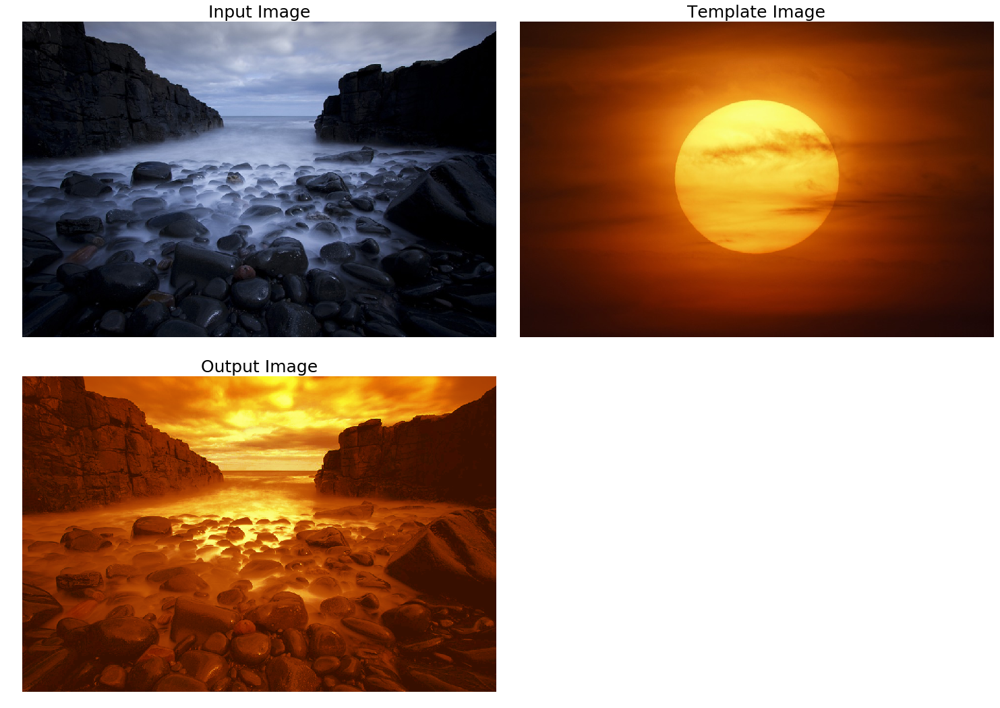

In [20]:
im = imread('images/rocks.jpg').astype(np.uint8)
im_t = imread('images/sun.jpg')
print(np.max(im), np.max(im_t))

im1 = np.zeros(im.shape).astype(np.uint8)
for i in range(3):
    c = cdf(im[...,i])
    c_t = cdf(im_t[...,i])
    im1[...,i] = hist_matching(c, c_t, im[...,i])

plt.figure(figsize=(20,15))
plt.subplots_adjust(left=0, top=0.95, right=1, bottom=0, wspace=0.05, hspace=0.05)
plt.subplot(221), plt.imshow(im), plt.axis('off'), plt.title('Input Image', size=25)
plt.subplot(222), plt.imshow(im_t), plt.axis('off'), plt.title('Template Image', size=25)
plt.subplot(223), plt.imshow(im1[...,:3]), plt.axis('off'), plt.title('Output Image', size=25)
plt.show()

### Removing Periodic Noise with LPF / Notch Filter

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel_launcher.py:39: ComplexWarning: Casting complex values to real discards the imaginary part


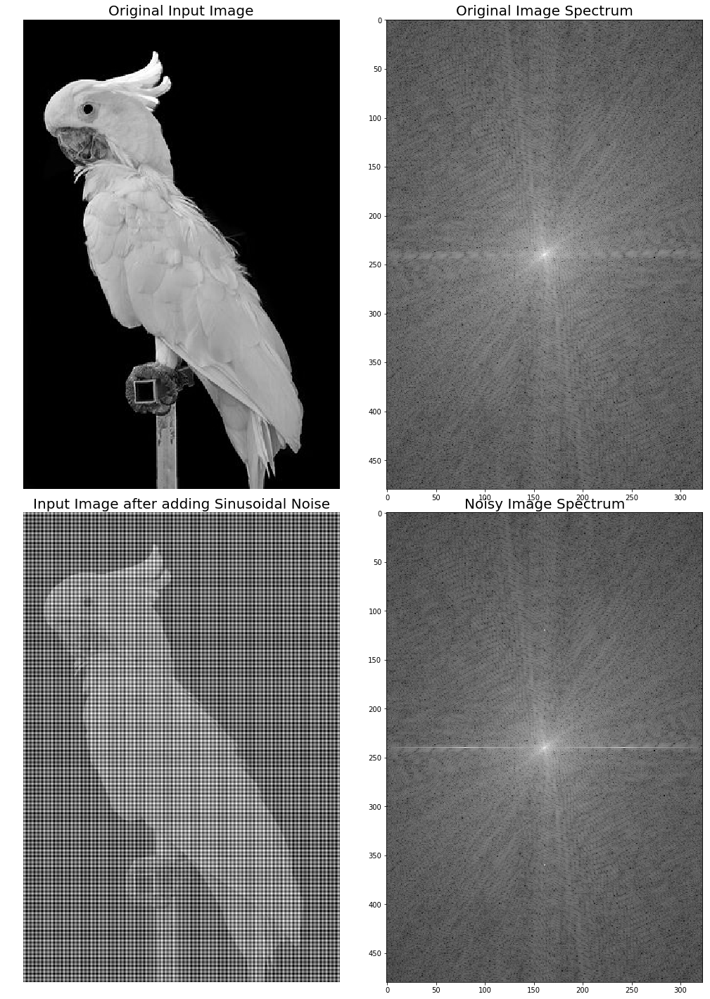

In [23]:
# !pip install --upgrade scipy
% matplotlib inline
from skimage.io import imread
from skimage.color import rgb2gray
import numpy.fft as fp
from scipy import signal, stats

#print(scipy.__version__)
im = rgb2gray(imread("images/bird.jpg"))
im1 = np.copy(im)

fig=plt.figure(figsize=(14,20))
fig.subplots_adjust(left=0, top=0.95, right=1, bottom=0, wspace=0.05, hspace=0.05)
plt.subplot(2,2,1) 
plt.imshow(im, cmap='gray')
plt.axis('off')
plt.title('Original Input Image', size=20)
#print(stats.signaltonoise(im, axis=None))
F1 = fp.fft2((im).astype(float))
F2 = fp.fftshift( F1 )
plt.subplot(2,2,2) 
plt.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=plt.cm.gray)
plt.xticks(np.arange(0, im.shape[1], 50))
plt.yticks(np.arange(0, im.shape[0], 50))
plt.title('Original Image Spectrum', size=20)

for n in range(im1.shape[0]):
    im1[n, :] += np.sin(0.1*np.pi*n*5)
for n in range(im1.shape[1]):
    im1[:, n] += np.sin(0.1*np.pi*n*5)
    
plt.subplot(2,2,3) 
plt.imshow(im1, cmap='gray')
plt.axis('off')
plt.title('Input Image after adding Sinusoidal Noise', size=20)
F1 = fp.fft2((im1).astype(float))
F2 = fp.fftshift( F1 )
plt.subplot(2,2,4) 
plt.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=plt.cm.gray)
plt.xticks(np.arange(0, im1.shape[1], 50))
plt.yticks(np.arange(0, im1.shape[0], 50))
plt.title('Noisy Image Spectrum', size=20)
#plt.tight_layout()
plt.show()

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel_launcher.py:5: ComplexWarning: Casting complex values to real discards the imaginary part
  """


4.889414324277747 -1.0


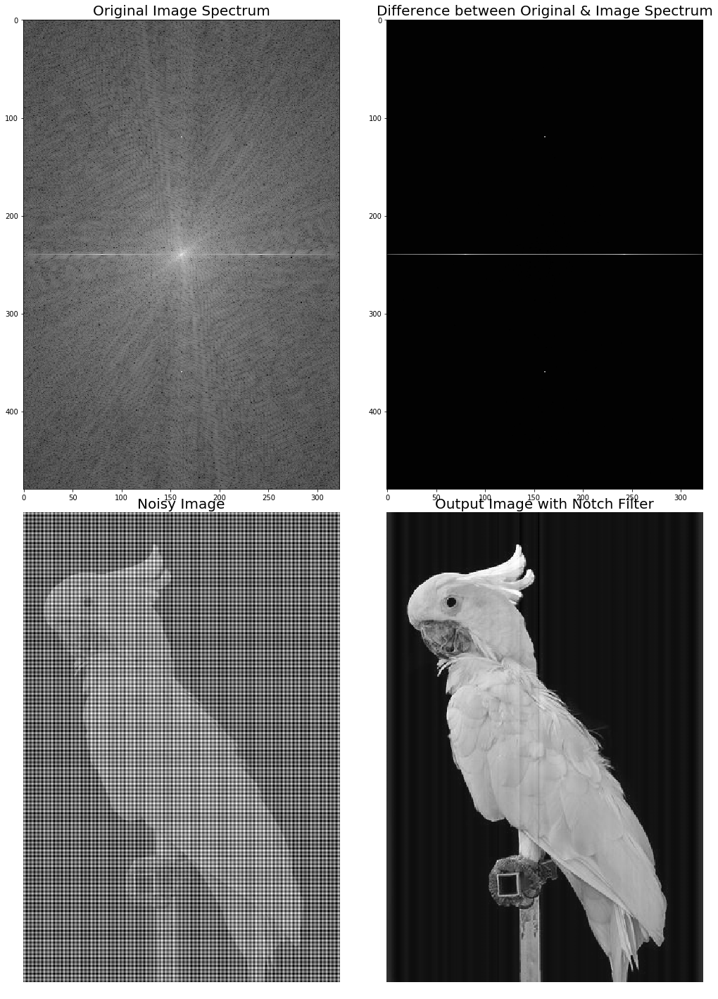

In [24]:
F1o = fp.fft2((im).astype(float))
F2o = fp.fftshift( F1o )
plt.figure(figsize=(14,20))
plt.subplots_adjust(left=0, top=0.95, right=1, bottom=0, wspace=0.05, hspace=0.05)
plt.subplot(221), plt.imshow( (20*np.log10( 0.1 + F2)).astype(int), cmap=plt.cm.gray), plt.title('Original Image Spectrum', size=20)
#print(np.where(abs(F2-F2o) > 0.05))
plt.subplot(222), plt.imshow( (20*np.log10( 0.1 + np.abs(F2-F2o))).astype(int), cmap=plt.cm.gray), plt.title('Difference between Original & Image Spectrum', size=20)
F2[240,:141] = F2[240,181:] = 0
F2[120,161] = F2[360,161] = 0
F1b = fp.ifftshift( F2 )
im2 =  fp.ifft2(F1b).real #np.abs()
#print(stats.signaltonoise(im1, axis=None))
plt.subplot(223), plt.axis('off'), plt.imshow(im1, cmap='gray'), plt.title('Noisy Image', size=20)
plt.subplot(224), plt.axis('off'), plt.imshow(im2, cmap='gray'), plt.title('Output Image with Notch Filter', size=20)
plt.show()

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\matplotlib\figure.py:403: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


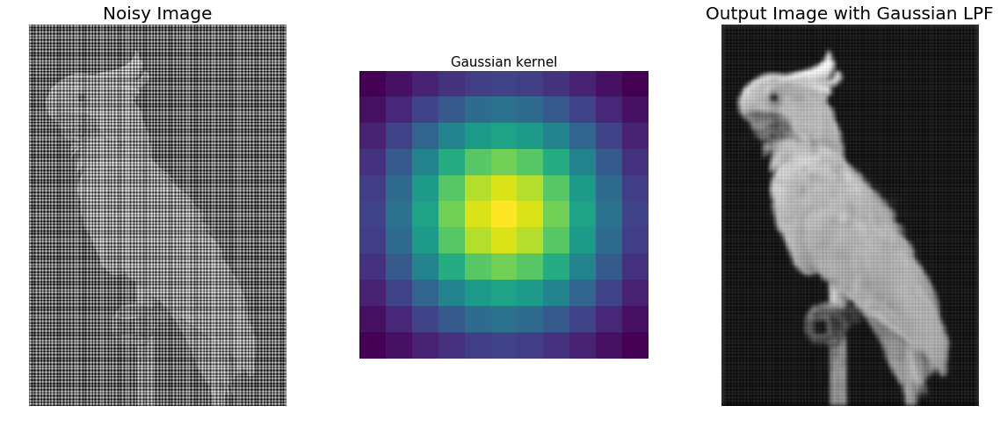

In [25]:
#2D Gaussian kernel of size 11x11 with σ = 3
gauss_kernel = np.outer(signal.gaussian(11, 3), signal.gaussian(11, 3)) 
im_blurred = signal.fftconvolve(im1, gauss_kernel, mode='same')
fig, (ax_original, ax_kernel, ax_blurred) = plt.subplots(1, 3, figsize=(20,8))
ax_original.imshow(im1, cmap='gray')
ax_original.set_title('Noisy Image', size=20)
ax_original.set_axis_off()
ax_kernel.imshow(gauss_kernel)
ax_kernel.set_title('Gaussian kernel', size=15)
ax_kernel.set_axis_off()
ax_blurred.imshow(im_blurred, cmap='gray')
ax_blurred.set_title('Output Image with Gaussian LPF', size=20)
ax_blurred.set_axis_off()
fig.show()

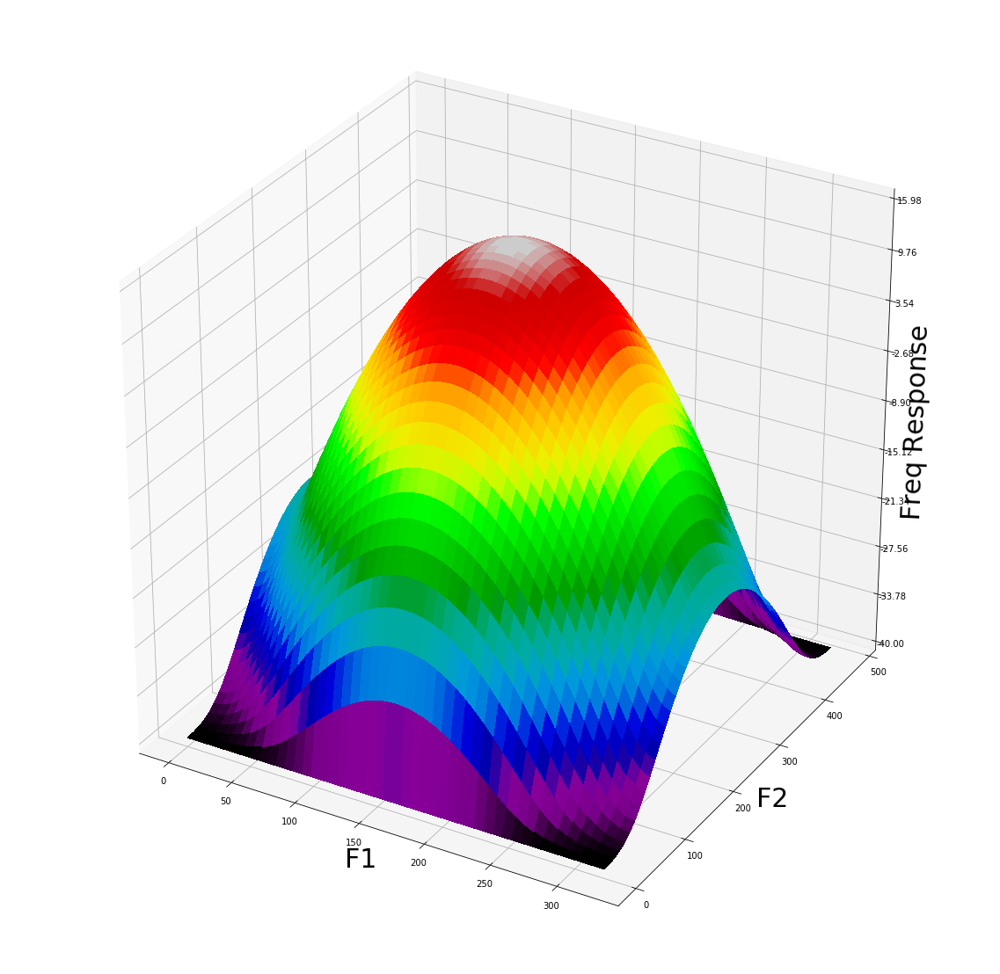

In [94]:
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.ticker import LinearLocator, FormatStrFormatter

def plot_3d(X, Y, Z, cmap=plt.cm.coolwarm):
    # Plot the surface.
    surf = ax.plot_surface(X, Y, Z, cmap=cmap, linewidth=0, antialiased=False)
    ax.zaxis.set_major_locator(LinearLocator(10))
    ax.zaxis.set_major_formatter(FormatStrFormatter('%.02f'))
    ax.set_xlabel('F1', size=30)
    ax.set_ylabel('F2', size=30)
    ax.set_zlabel('Freq Response', size=30)
    plt.show()    

kernel = np.outer(signal.gaussian(im.shape[0], 1), signal.gaussian(im.shape[1], 1))
freq = fp.fft2((im1).astype(float))
freq_kernel = fp.fft2(fp.ifftshift(kernel))
convolved = freq*freq_kernel # by the Convolution theorem
im_blur = fp.ifft2(convolved).real
im_blur = 255 * im_blur / np.max(im_blur)

fig = plt.figure(figsize=(20,20))
ax = fig.gca(projection='3d')
Y = np.arange(freq_kernel.shape[0]) #-freq.shape[0]//2,freq.shape[0]-freq.shape[0]//2)
X = np.arange(freq_kernel.shape[1]) #-freq.shape[1]//2,freq.shape[1]-freq.shape[1]//2)
X, Y = np.meshgrid(X, Y)
Z = (20*np.log10( 0.01 + fp.fftshift(freq_kernel))).real
plot_3d(X,Y,Z, plt.cm.spectral)

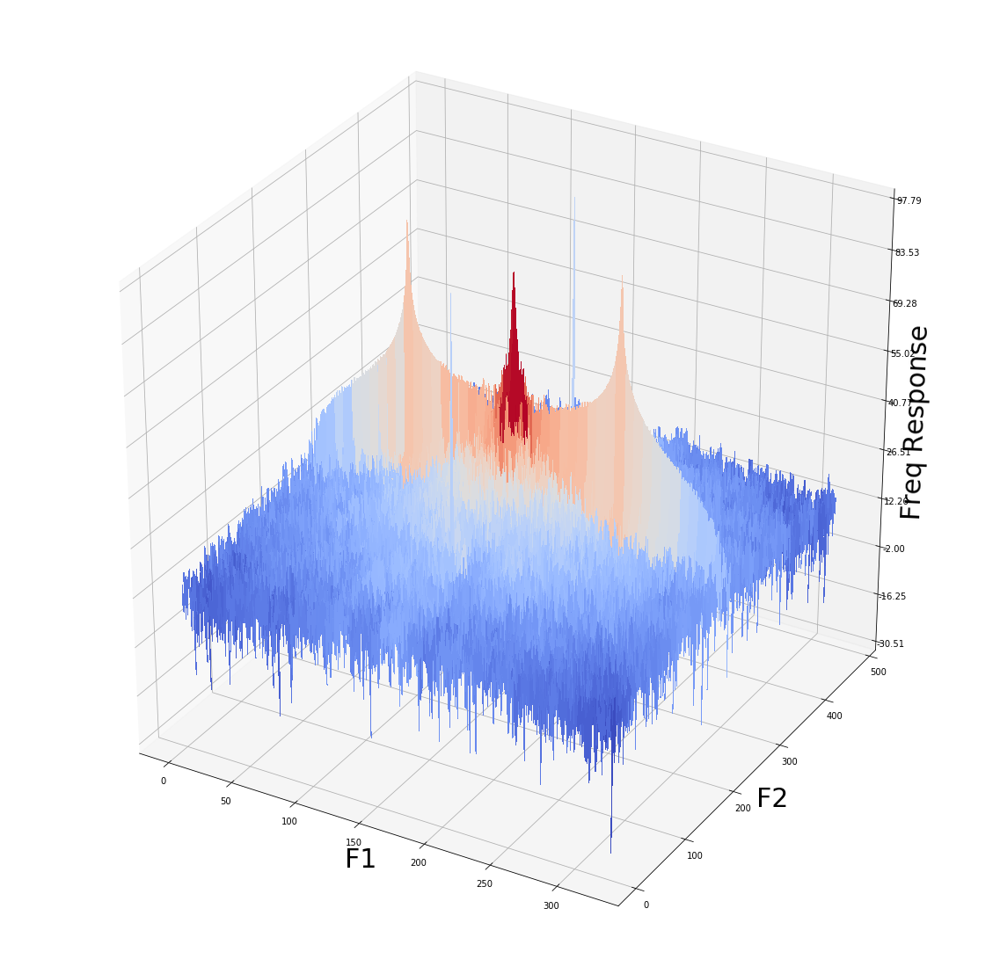

In [95]:
fig = plt.figure(figsize=(20,20))
ax = fig.gca(projection='3d')
Z = (20*np.log10( 0.01 + fp.fftshift(freq))).real
plot_3d(X,Y,Z)

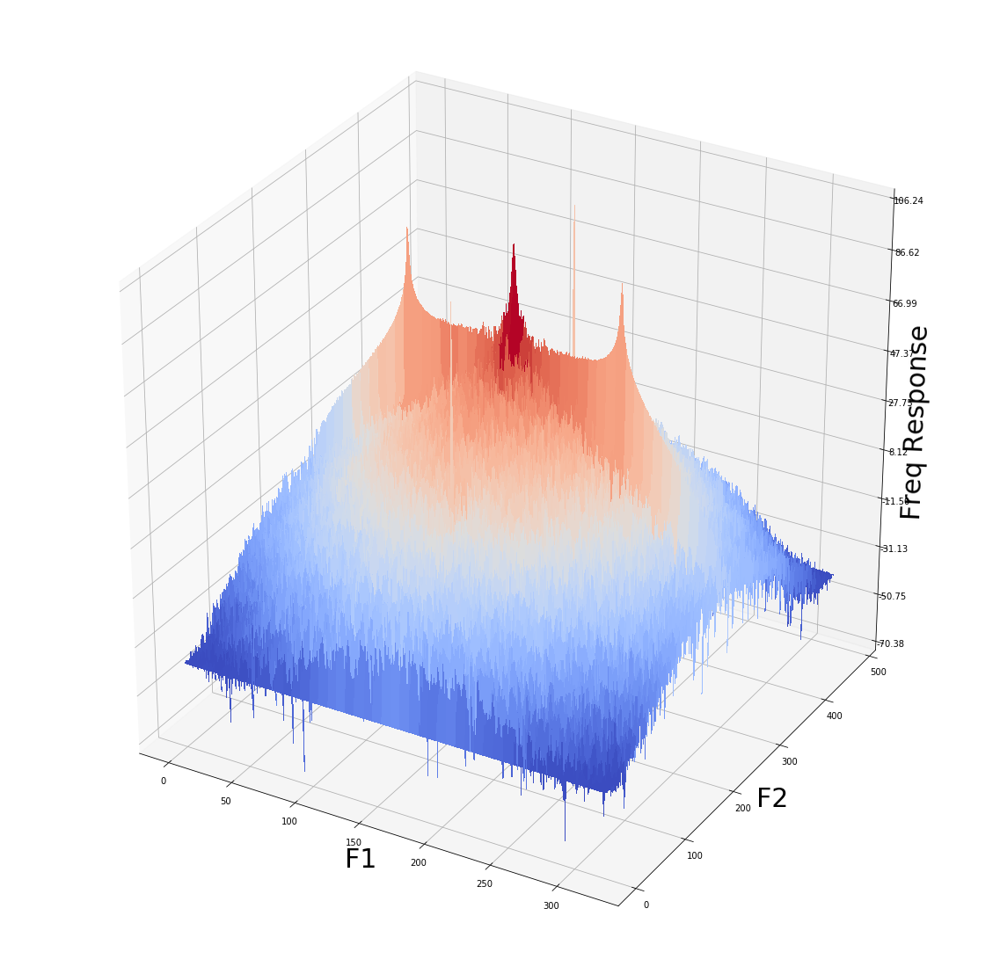

In [96]:
fig = plt.figure(figsize=(20,20))
ax = fig.gca(projection='3d')
Z = (20*np.log10( 0.01 + fp.fftshift(convolved))).real
plot_3d(X,Y,Z)

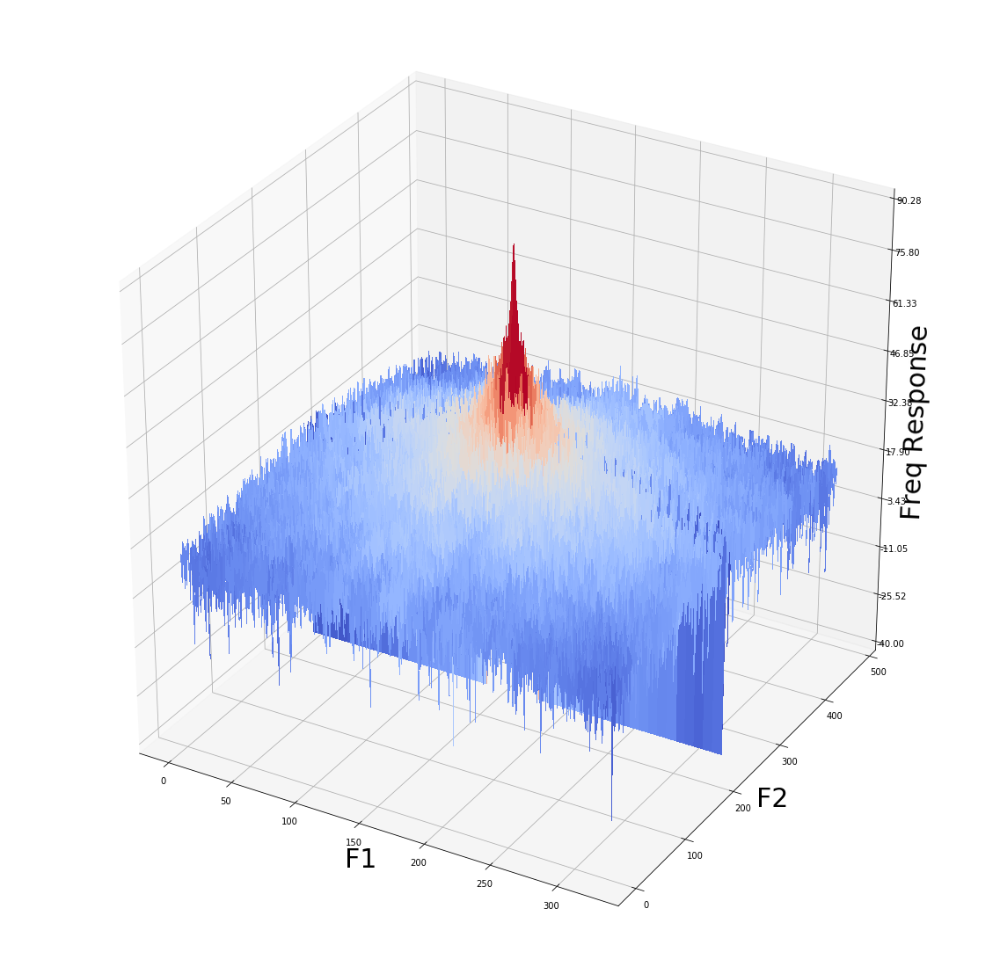

In [97]:
freq = fp.fftshift(freq)
freq[240,:141] = freq[240,181:] = freq[120,161] = freq[360,161] = 0
im_notch = fp.ifft2(fp.ifftshift(freq)).real
#im_notch = 255*(np.max(im_notch) - im_notch) / (np.max(im_notch) - np.min(im_notch))
fig = plt.figure(figsize=(20,20))
ax = fig.gca(projection='3d')
Z = (20*np.log10( 0.01 + freq)).real
plot_3d(X,Y,Z)

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\matplotlib\figure.py:403: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


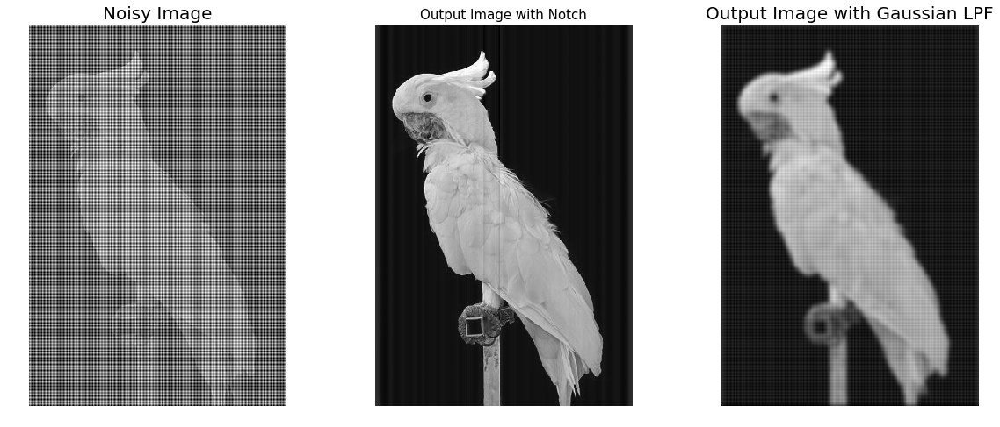

In [98]:
fig, (ax_original, ax_notch, ax_blurred) = plt.subplots(1, 3, figsize=(20,8))
ax_original.imshow(im1, cmap='gray')
ax_original.set_title('Noisy Image', size=20)
ax_original.set_axis_off()
ax_notch.imshow(im_notch, cmap='gray')
ax_notch.set_title('Output Image with Notch', size=15)
ax_notch.set_axis_off()
ax_blurred.imshow(im_blurred, cmap='gray')
ax_blurred.set_title('Output Image with Gaussian LPF', size=20)
ax_blurred.set_axis_off()
fig.show()

### Denoising with DCT

estimated noise standard deviation = 0.15142300131438588


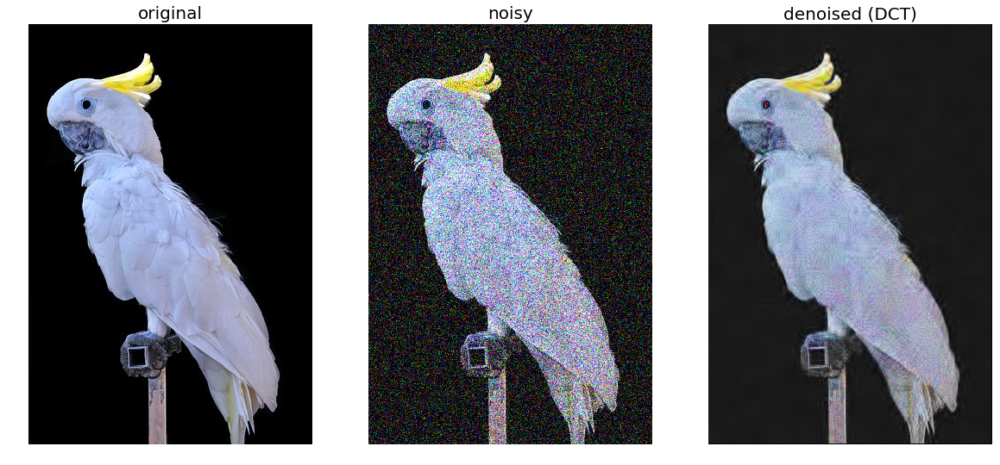

In [14]:
import cv2
from skimage import img_as_float
from skimage.restoration import estimate_sigma
im = img_as_float(imread('images/bird.jpg'))
sigma = 0.25
noisy = im + sigma * np.random.standard_normal(im.shape)
noisy = np.clip(noisy, 0, 1)
# you can estimate the noise standard deviation from the noisy image using the estimate_sigma function
sigma_est = np.mean(estimate_sigma(noisy, multichannel=True))
print("estimated noise standard deviation = {}".format(sigma_est))
out = noisy.copy()
cv2.xphoto.dctDenoising(noisy, out, sigma_est)
plt.figure(figsize=(20,10))
plt.subplot(131), plt.imshow(im), plt.axis('off'), plt.title('original', size=20)
plt.subplot(132), plt.imshow(noisy), plt.axis('off'), plt.title('noisy', size=20)
plt.subplot(133), plt.imshow(out), plt.axis('off'), plt.title('denoised (DCT)', size=20)
plt.show()

### Fake Miniature

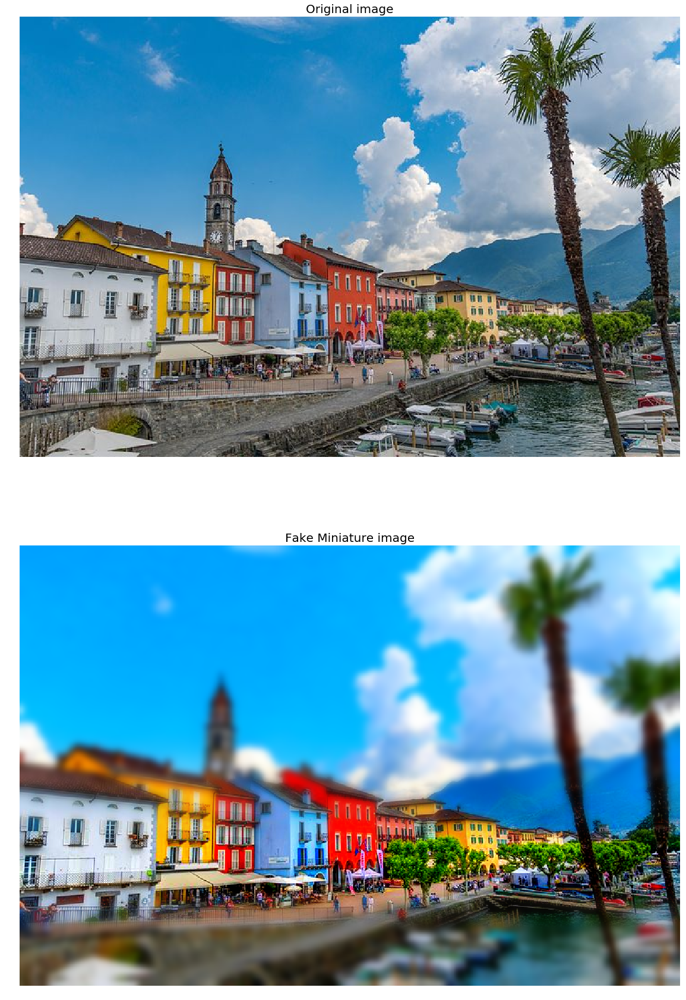

In [124]:
from PIL import Image, ImageEnhance, ImageDraw, ImageOps, ImageFilter
from scipy.ndimage import gaussian_filter
import matplotlib.pyplot as plt, numpy as np

mask_width, mask_height = 640, 480

def create_fake_miniature(im, pts, custom_mask=None, dof=40, color=1.9, contrast=1.4, offset_focus=9):
    # Cranking up the contrast and color
    edited = ImageEnhance.Contrast(ImageEnhance.Color(im).enhance(color)).enhance(contrast)
    # Determining whether we want a focal line mask or a custom mask (bells and whistles)
    if not custom_mask:
        # Creating the mask for a focal line
        offset = int(pts[0][1] / im.size[1] * mask_height)
        #print(pts[0][1], im.size[1], mask_height, offset) 
        va = int(offset + 81.6)
        focus = int(va + offset_focus * 4.8)
        vb = int(focus + 43.2)
        #print(va, vb)
        
        mask, m1 = Image.new('L', (mask_width, mask_height)), Image.new('L', (1, mask_height))
        d1 = ImageDraw.Draw(m1)
        for i in range (0, offset):
            d1.point((0, i), 255)
        for i in range (offset, va):
            d1.point((0, i), int((va - i) * (255 / (va - offset))))
        for i in range (va, focus):
            d1.point((0, i), 0)
        for i in range (focus, vb):
            d1.point((0, i), int(255 - (vb - i) * (255 / (vb - focus))))
        for i in range (vb, mask_height):
            d1.point((0, i), 255)
        mt = ImageOps.invert(ImageOps.invert(m1.resize((int(mask.size[0] * 3), mask.size[1]), Image.ANTIALIAS)).rotate(0, Image.NEAREST, 1))
        mask.convert("RGBA")
        mask.paste(mt,(-mt.size[0] // 2, -(mt.size[1] // 2 - mask_height // 2)))
        mask.convert("L")
        mask = mask.resize(edited.size)
    else:
        #mask = custom_mask.convert("1")
        lol = Image.fromarray(np.uint8(gaussian_filter(np.array(custom_mask, dtype=float), sigma=[3, 3, 0])))
        mask = lol.convert("1")
        # mask = mask.point(lambda i:i*(1./256)).convert('L') #.filter(ImageFilter.SMOOTH)
        #return lol

    # Blurring the image and merging
    if custom_mask:
        im_blur = Image.fromarray(np.uint8(gaussian_filter(np.array(edited, dtype=float), sigma=[1, 1, 0])))
    else:
        im_blur = Image.fromarray(np.uint8(gaussian_filter(np.array(edited, dtype=float), sigma=[4, 4, 0])))
    edited = edited.convert("RGBA")
    edited.paste(im_blur, mask=mask)

    return edited

im = Image.open("images/ascona.jpg")
#mask = Image.open("images/min_mask.jpg")
out = create_fake_miniature(im, [[50, 250]]) #, mask)
plt.figure(figsize=(20,30))
plt.subplot(211), plt.imshow(im), plt.axis('off'), plt.title('Original image', size=20)
plt.subplot(212), plt.imshow(out), plt.axis('off'), plt.title('Fake Miniature image', size=20)
plt.show()

### Edge Detection with Canny, LOG / Zero-Crossing and Wavelets

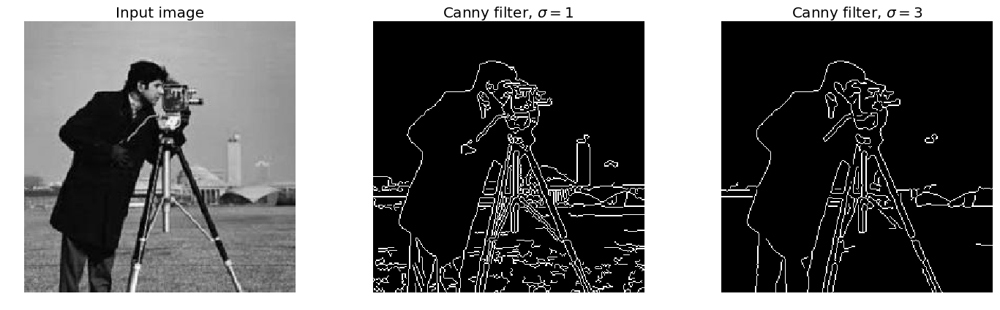

In [69]:
import matplotlib.pyplot as plt
import SimpleITK as sitk

image = sitk.ReadImage('images/cameraman.jpg') # 8-bit cameraman grayscale image
image = sitk.Cast(image, sitk.sitkFloat64)

# Compute the Canny filter for two values of sigma
edges1 = sitk.CannyEdgeDetection(image, lowerThreshold=5, upperThreshold=10, variance=[1, 1])
edges2 = sitk.CannyEdgeDetection(image, lowerThreshold=5, upperThreshold=10, variance=[3, 3])

# Convert to numpy array for display
image = sitk.GetArrayFromImage(image)
edges1 = sitk.GetArrayFromImage(edges1)
edges2 = sitk.GetArrayFromImage(edges2)

# display results
fig = plt.figure(figsize=(20, 6))

plt.subplot(131), plt.imshow(image, cmap=plt.cm.gray), plt.axis('off'), plt.title('Input image', fontsize=20)
plt.subplot(132), plt.imshow(edges1, cmap=plt.cm.gray), plt.axis('off'), plt.title('Canny filter, $\sigma=1$', fontsize=20)
plt.subplot(133), plt.imshow(edges2, cmap=plt.cm.gray), plt.axis('off'), plt.title('Canny filter, $\sigma=3$', fontsize=20)

fig.tight_layout()

plt.show()

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel_launcher.py:23: DeprecationWarning: `imread` is deprecated!
`imread` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``imageio.imread`` instead.


1.0


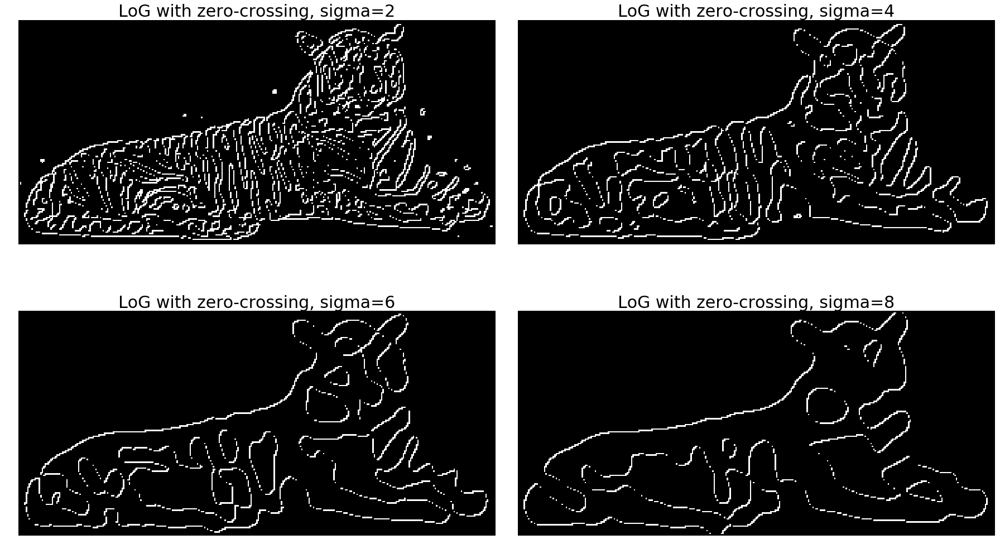

In [217]:
import numpy as np
from scipy import ndimage, misc
import matplotlib.pyplot as plt
from skimage.color import rgb2gray

def any_neighbor_zero(img, i, j):
    for k in range(-1,2):
      for l in range(-1,2):
         if img[i+k, j+k] == 0:
            return True
    return False

def zero_crossing(img):
  img[img > 0] = 1
  img[img < 0] = 0
  out_img = np.zeros(img.shape)
  for i in range(1,img.shape[0]-1):
    for j in range(1,img.shape[1]-1):
      if img[i,j] > 0 and any_neighbor_zero(img, i, j):
        out_img[i,j] = 255
  return out_img

img = rgb2gray(misc.imread('images/tiger.jpg'))

print(np.max(img))
fig = plt.figure(figsize=(25,15))
plt.gray() # show the filtered result in grayscale
for sigma in range(2,10, 2):
    plt.subplot(2,2,sigma/2)
    result = ndimage.gaussian_laplace(img, sigma=sigma)
    result = zero_crossing(result)
    plt.imshow(result)
    plt.axis('off')
    plt.title('LoG with zero-crossing, sigma=' + str(sigma), size=30)

plt.tight_layout()
plt.show()

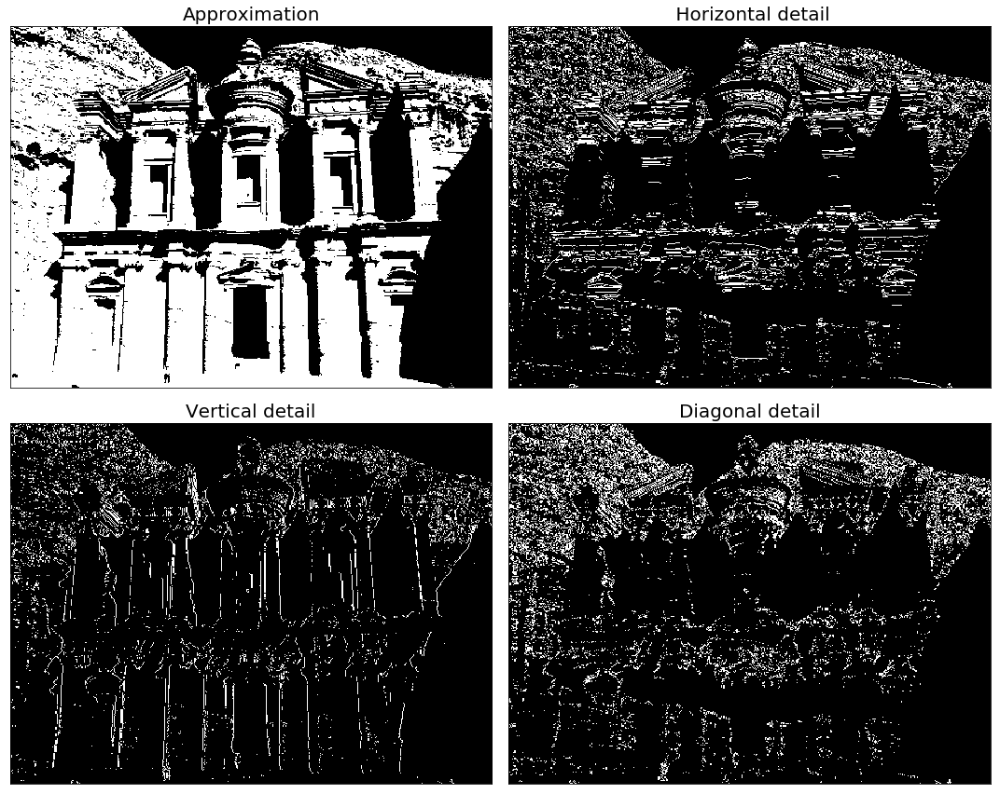

In [6]:
% matplotlib inline
import pywt
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.filters import threshold_otsu
import matplotlib.pylab as plt
# Load image
original = rgb2gray(imread('images/ed-deir.jpg'))
#original = pywt.data.camera()
# Wavelet transform of image, and plot approximation and details
titles = ['Approximation', ' Horizontal detail', 'Vertical detail', 'Diagonal detail']
coeffs2 = pywt.dwt2(original, 'haar')
LL, (LH, HL, HH) = coeffs2
fig = plt.figure(figsize=(15, 12))
for i, a in enumerate([LL, LH, HL, HH]):
    ax = fig.add_subplot(2, 2, i + 1)
    a = abs(a)
    #a = np.clip(a, 0, 1)
    th = threshold_otsu(a)
    a[a > th] = 1
    a[a <= th] = 0
    ax.imshow(a, interpolation="nearest", cmap=plt.cm.gray)
    ax.set_title(titles[i], fontsize=20)
    ax.set_xticks([])
    ax.set_yticks([])
fig.tight_layout()
plt.show()

### Image Denoising with Denoising Autoencoder

(1288, 50, 37)
epoch [1/100], loss:0.6724, MSE_loss:0.0134
epoch [2/100], loss:0.6678, MSE_loss:0.0131
epoch [3/100], loss:0.6526, MSE_loss:0.0181
epoch [4/100], loss:0.6628, MSE_loss:0.0149
epoch [5/100], loss:0.6355, MSE_loss:0.0123
epoch [6/100], loss:0.6485, MSE_loss:0.0107
epoch [7/100], loss:0.6604, MSE_loss:0.0086
epoch [8/100], loss:0.6585, MSE_loss:0.0102
epoch [9/100], loss:0.6468, MSE_loss:0.0097
epoch [10/100], loss:0.6530, MSE_loss:0.0114


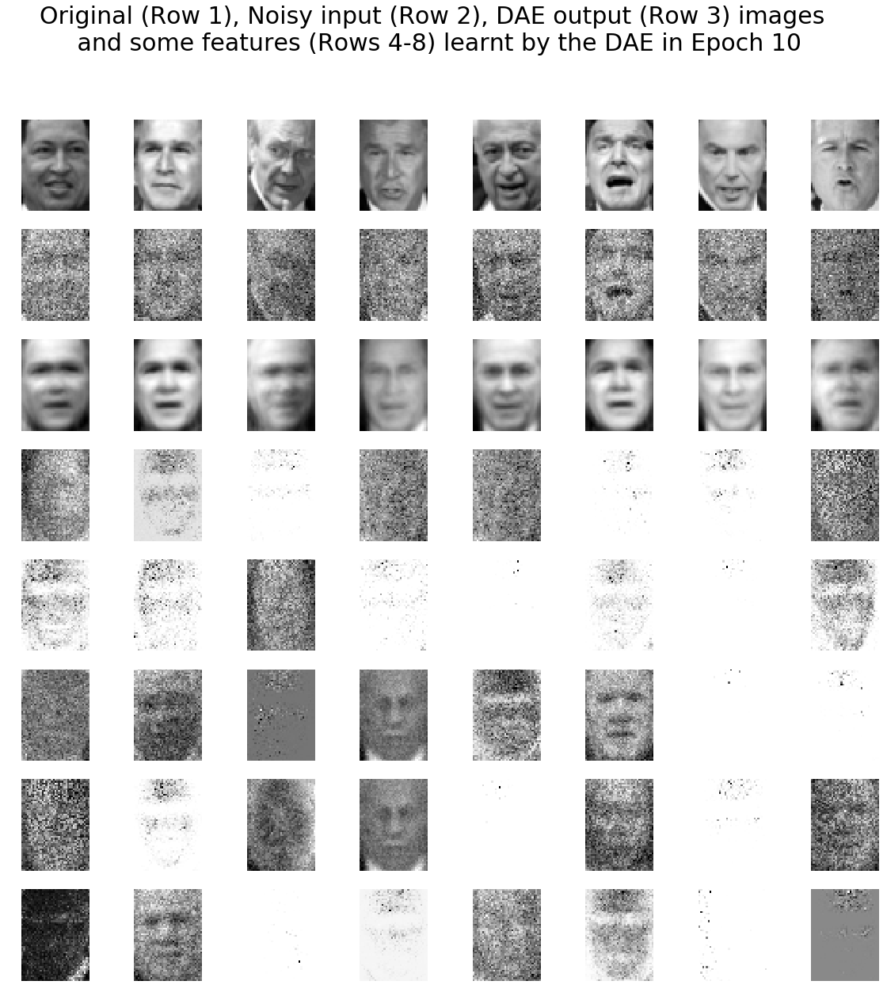

epoch [11/100], loss:0.6542, MSE_loss:0.0101
epoch [12/100], loss:0.6491, MSE_loss:0.0085
epoch [13/100], loss:0.6388, MSE_loss:0.0083
epoch [14/100], loss:0.6547, MSE_loss:0.0080
epoch [15/100], loss:0.6378, MSE_loss:0.0088
epoch [16/100], loss:0.6497, MSE_loss:0.0062
epoch [17/100], loss:0.6571, MSE_loss:0.0053
epoch [18/100], loss:0.6475, MSE_loss:0.0076
epoch [19/100], loss:0.6519, MSE_loss:0.0073
epoch [20/100], loss:0.6383, MSE_loss:0.0104


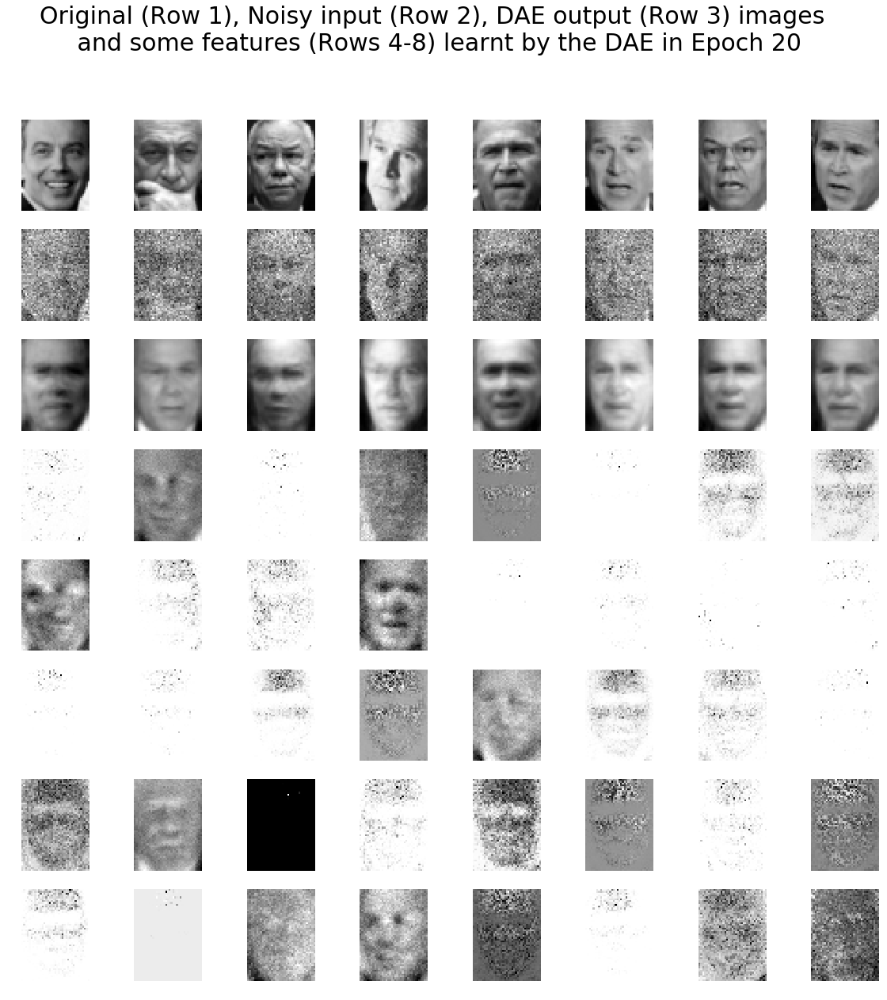

epoch [21/100], loss:0.6497, MSE_loss:0.0058
epoch [22/100], loss:0.6352, MSE_loss:0.0071
epoch [23/100], loss:0.6360, MSE_loss:0.0066
epoch [24/100], loss:0.6488, MSE_loss:0.0076
epoch [25/100], loss:0.6436, MSE_loss:0.0112
epoch [26/100], loss:0.6436, MSE_loss:0.0068
epoch [27/100], loss:0.6461, MSE_loss:0.0060
epoch [28/100], loss:0.6492, MSE_loss:0.0058
epoch [29/100], loss:0.6456, MSE_loss:0.0079
epoch [30/100], loss:0.6486, MSE_loss:0.0075


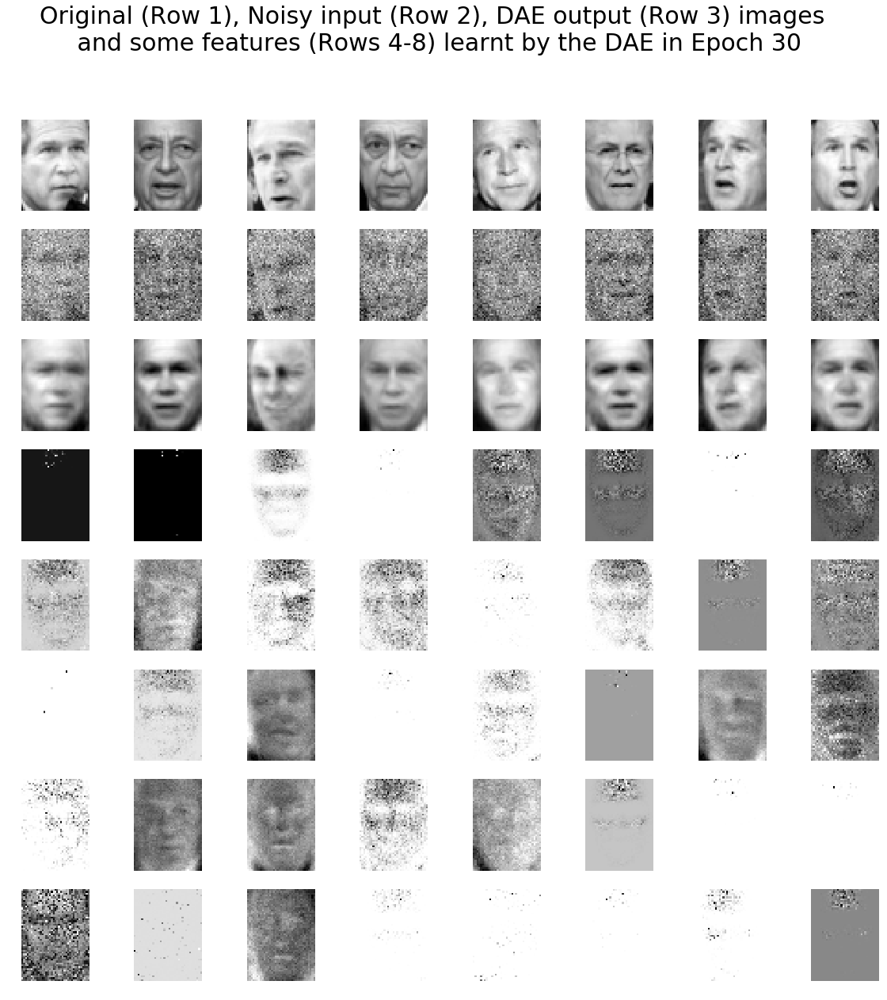

epoch [31/100], loss:0.6376, MSE_loss:0.0078
epoch [32/100], loss:0.6403, MSE_loss:0.0063
epoch [33/100], loss:0.6418, MSE_loss:0.0068
epoch [34/100], loss:0.6378, MSE_loss:0.0068
epoch [35/100], loss:0.6451, MSE_loss:0.0076
epoch [36/100], loss:0.6449, MSE_loss:0.0080
epoch [37/100], loss:0.6411, MSE_loss:0.0064
epoch [38/100], loss:0.6540, MSE_loss:0.0064
epoch [39/100], loss:0.6542, MSE_loss:0.0054
epoch [40/100], loss:0.6514, MSE_loss:0.0062


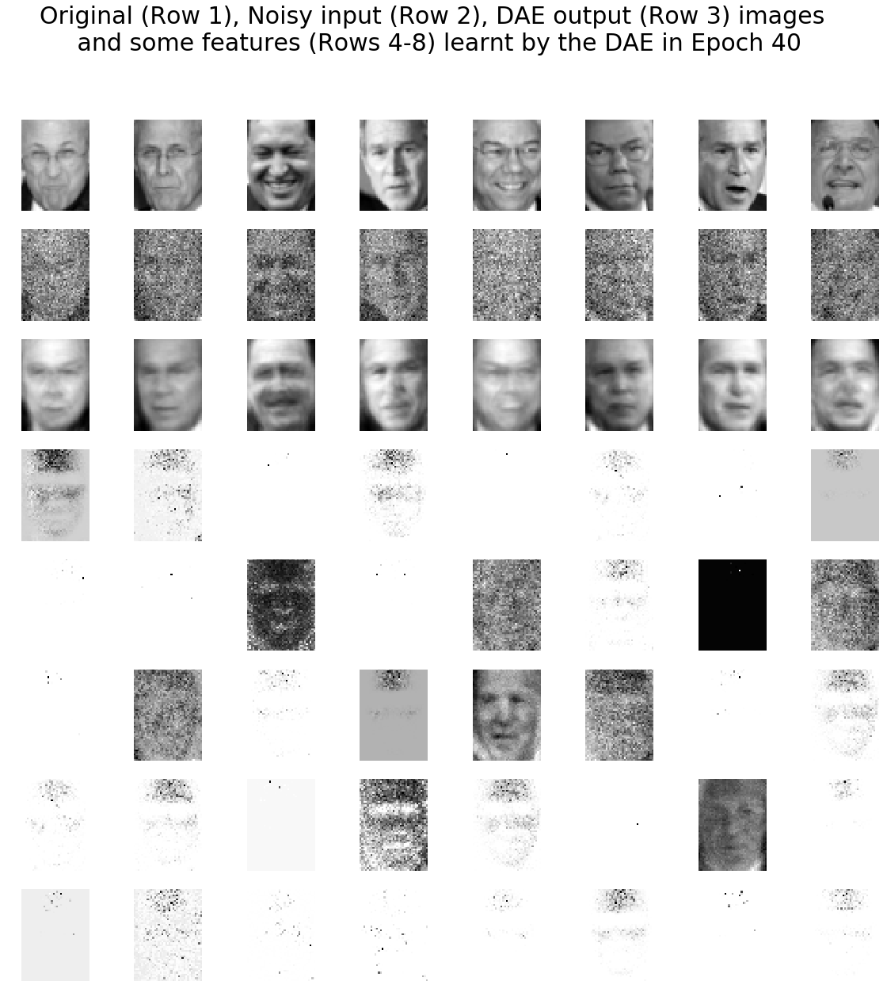

epoch [41/100], loss:0.6498, MSE_loss:0.0060
epoch [42/100], loss:0.6426, MSE_loss:0.0068
epoch [43/100], loss:0.6365, MSE_loss:0.0065
epoch [44/100], loss:0.6440, MSE_loss:0.0071
epoch [45/100], loss:0.6407, MSE_loss:0.0069
epoch [46/100], loss:0.6385, MSE_loss:0.0068
epoch [47/100], loss:0.6154, MSE_loss:0.0064
epoch [48/100], loss:0.6459, MSE_loss:0.0065
epoch [49/100], loss:0.6431, MSE_loss:0.0056
epoch [50/100], loss:0.6421, MSE_loss:0.0073


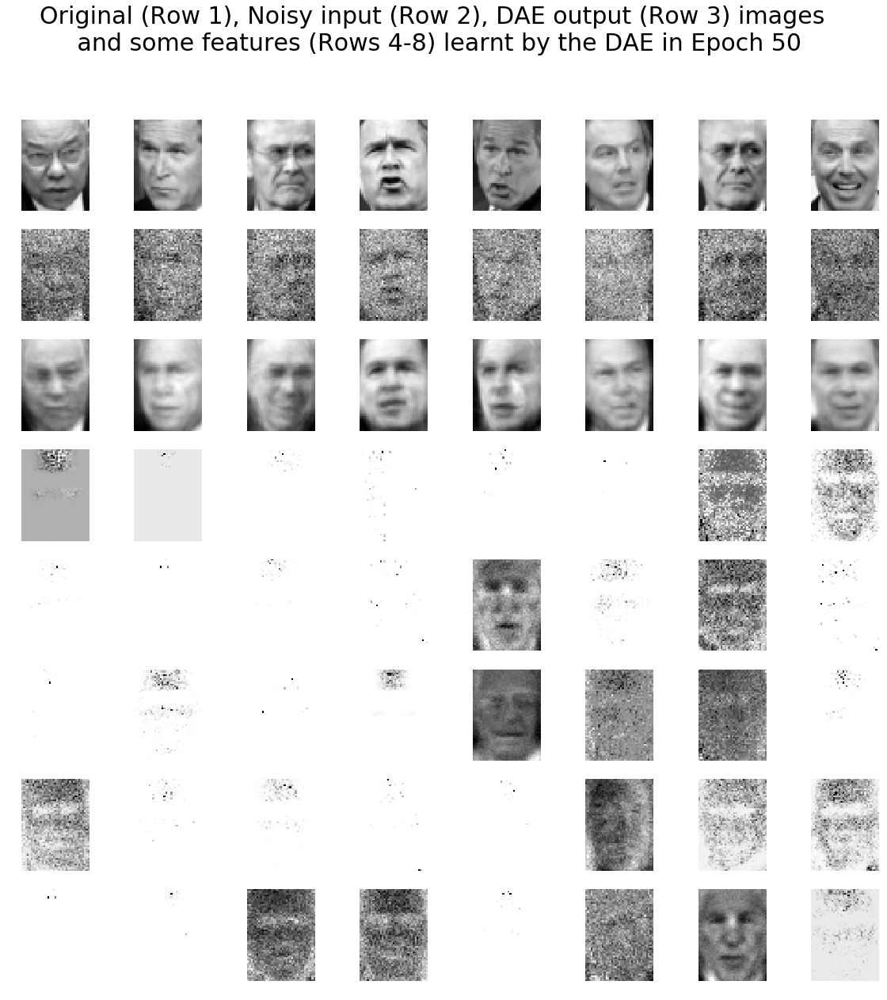

epoch [51/100], loss:0.6358, MSE_loss:0.0080
epoch [52/100], loss:0.6452, MSE_loss:0.0074
epoch [53/100], loss:0.6332, MSE_loss:0.0083
epoch [54/100], loss:0.6310, MSE_loss:0.0057
epoch [55/100], loss:0.6451, MSE_loss:0.0070
epoch [56/100], loss:0.6521, MSE_loss:0.0092
epoch [57/100], loss:0.6372, MSE_loss:0.0071
epoch [58/100], loss:0.6402, MSE_loss:0.0055
epoch [59/100], loss:0.6429, MSE_loss:0.0058
epoch [60/100], loss:0.6368, MSE_loss:0.0064


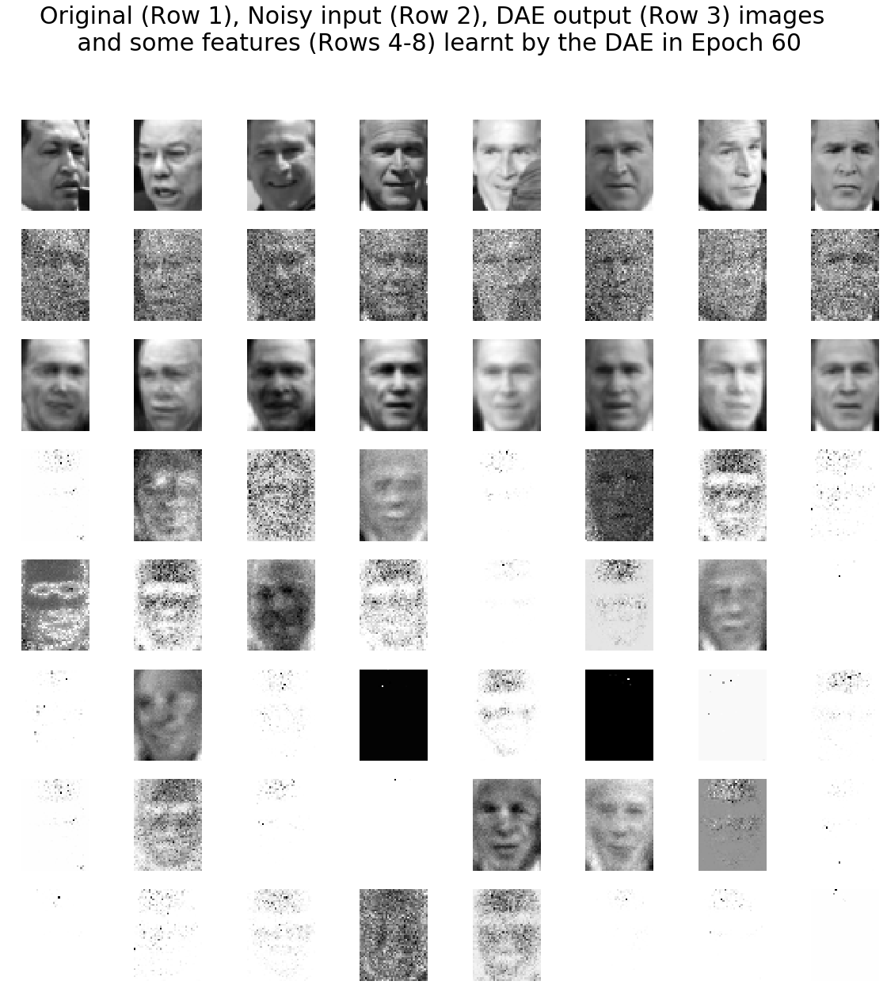

epoch [61/100], loss:0.6599, MSE_loss:0.0058
epoch [62/100], loss:0.6389, MSE_loss:0.0059
epoch [63/100], loss:0.6427, MSE_loss:0.0072
epoch [64/100], loss:0.6397, MSE_loss:0.0064
epoch [65/100], loss:0.6390, MSE_loss:0.0066
epoch [66/100], loss:0.6369, MSE_loss:0.0052
epoch [67/100], loss:0.6494, MSE_loss:0.0059
epoch [68/100], loss:0.6231, MSE_loss:0.0077
epoch [69/100], loss:0.6432, MSE_loss:0.0067
epoch [70/100], loss:0.6443, MSE_loss:0.0059


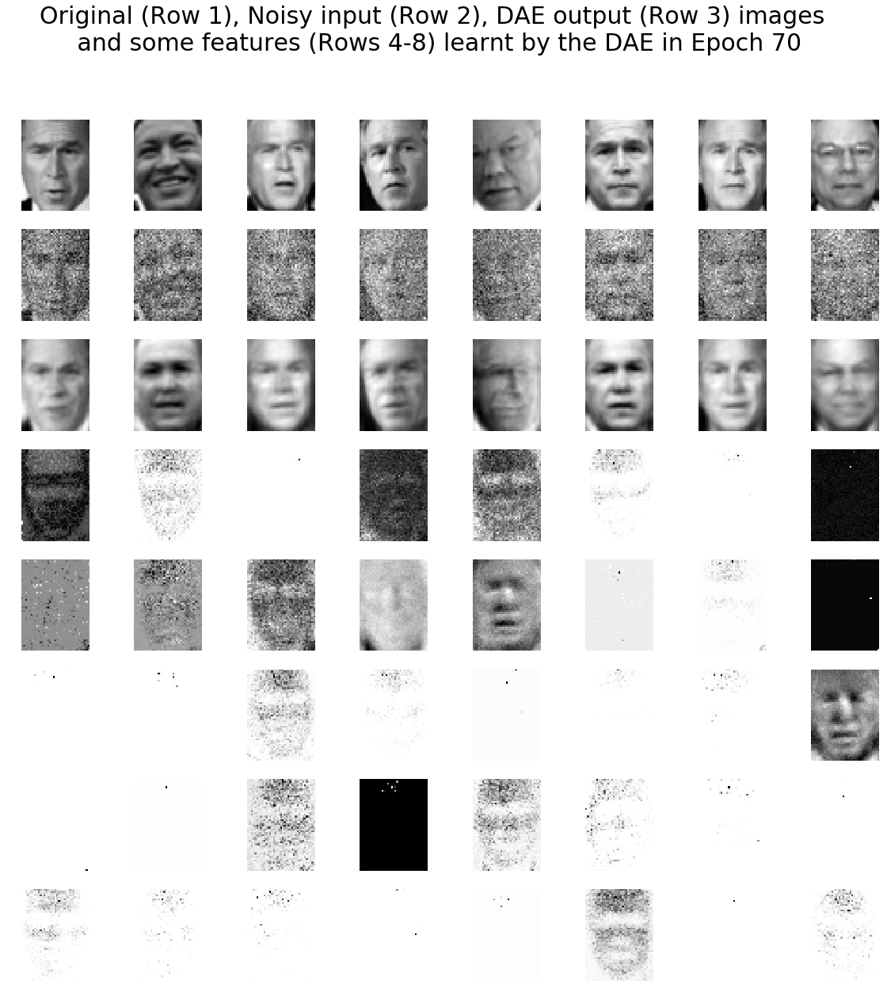

epoch [71/100], loss:0.6324, MSE_loss:0.0053
epoch [72/100], loss:0.6424, MSE_loss:0.0054
epoch [73/100], loss:0.6475, MSE_loss:0.0052
epoch [74/100], loss:0.6482, MSE_loss:0.0067
epoch [75/100], loss:0.6456, MSE_loss:0.0061
epoch [76/100], loss:0.6525, MSE_loss:0.0059
epoch [77/100], loss:0.6436, MSE_loss:0.0051
epoch [78/100], loss:0.6235, MSE_loss:0.0070
epoch [79/100], loss:0.6412, MSE_loss:0.0063
epoch [80/100], loss:0.6488, MSE_loss:0.0073


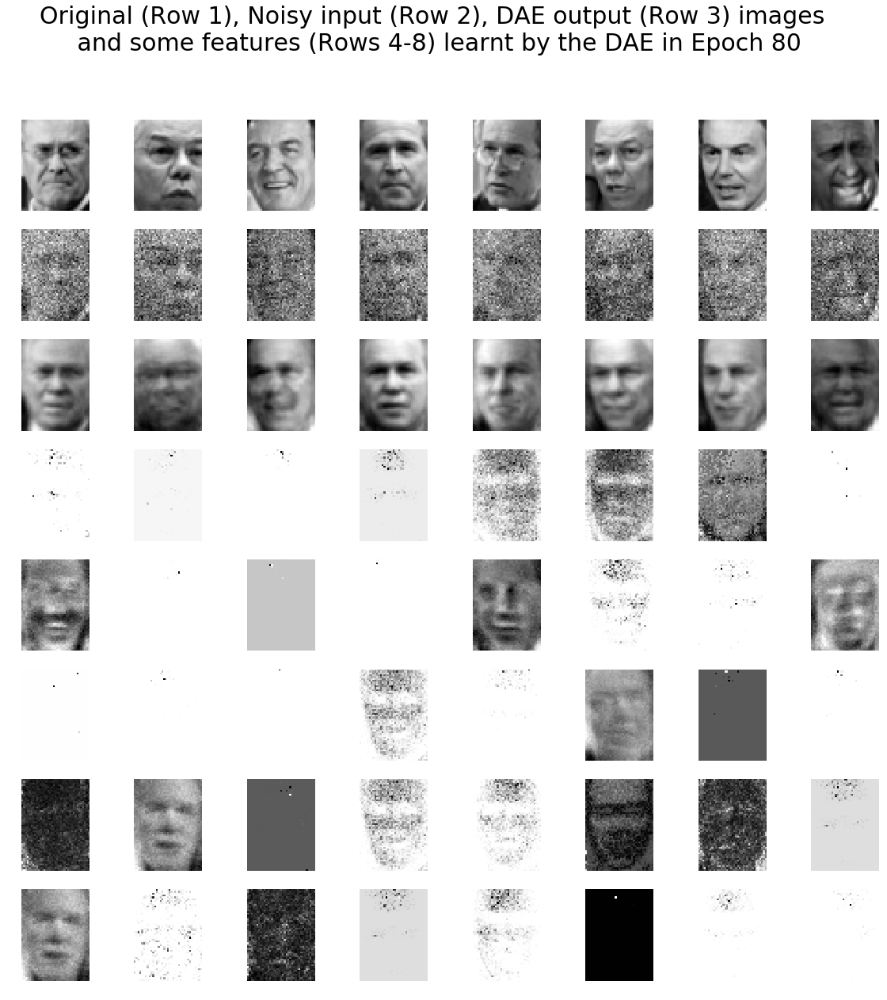

epoch [81/100], loss:0.6321, MSE_loss:0.0070
epoch [82/100], loss:0.6441, MSE_loss:0.0058
epoch [83/100], loss:0.6270, MSE_loss:0.0067
epoch [84/100], loss:0.6310, MSE_loss:0.0054
epoch [85/100], loss:0.6367, MSE_loss:0.0060
epoch [86/100], loss:0.6525, MSE_loss:0.0051
epoch [87/100], loss:0.6440, MSE_loss:0.0050
epoch [88/100], loss:0.6434, MSE_loss:0.0069
epoch [89/100], loss:0.6507, MSE_loss:0.0050
epoch [90/100], loss:0.6460, MSE_loss:0.0063


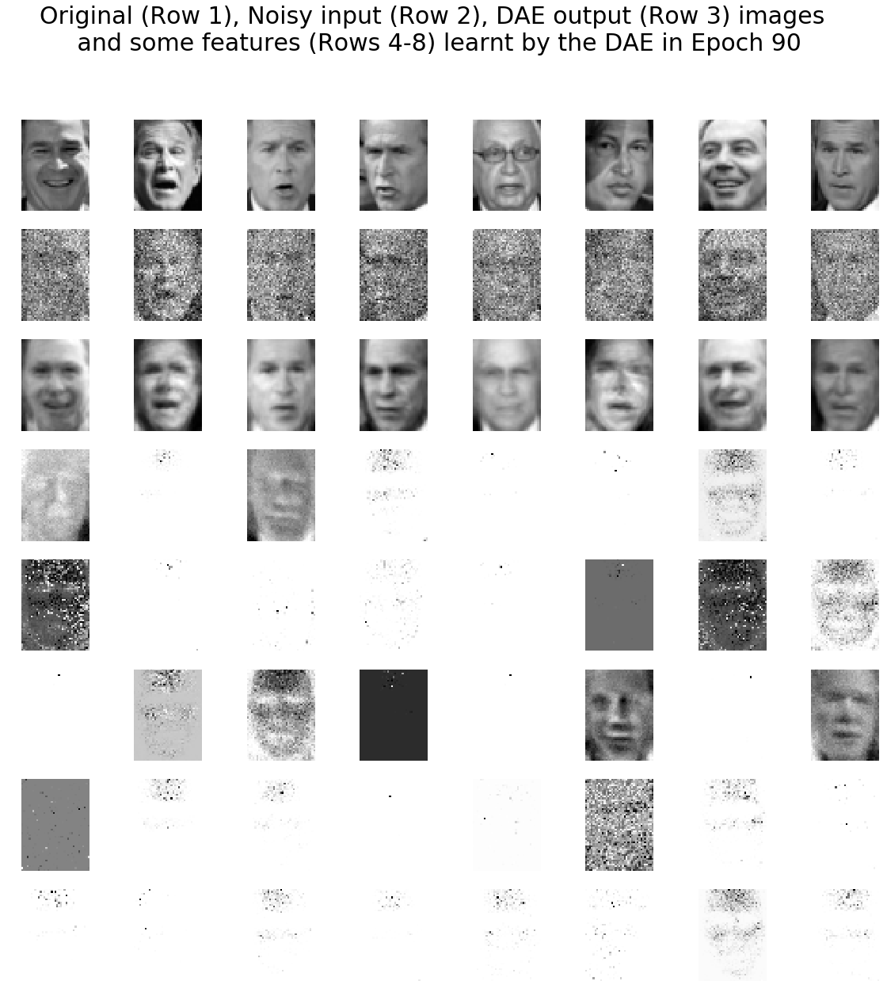

epoch [91/100], loss:0.6472, MSE_loss:0.0063
epoch [92/100], loss:0.6492, MSE_loss:0.0045
epoch [93/100], loss:0.6324, MSE_loss:0.0069
epoch [94/100], loss:0.6476, MSE_loss:0.0048
epoch [95/100], loss:0.6436, MSE_loss:0.0060
epoch [96/100], loss:0.6452, MSE_loss:0.0058
epoch [97/100], loss:0.6460, MSE_loss:0.0050
epoch [98/100], loss:0.6556, MSE_loss:0.0051
epoch [99/100], loss:0.6287, MSE_loss:0.0061
epoch [100/100], loss:0.6455, MSE_loss:0.0056


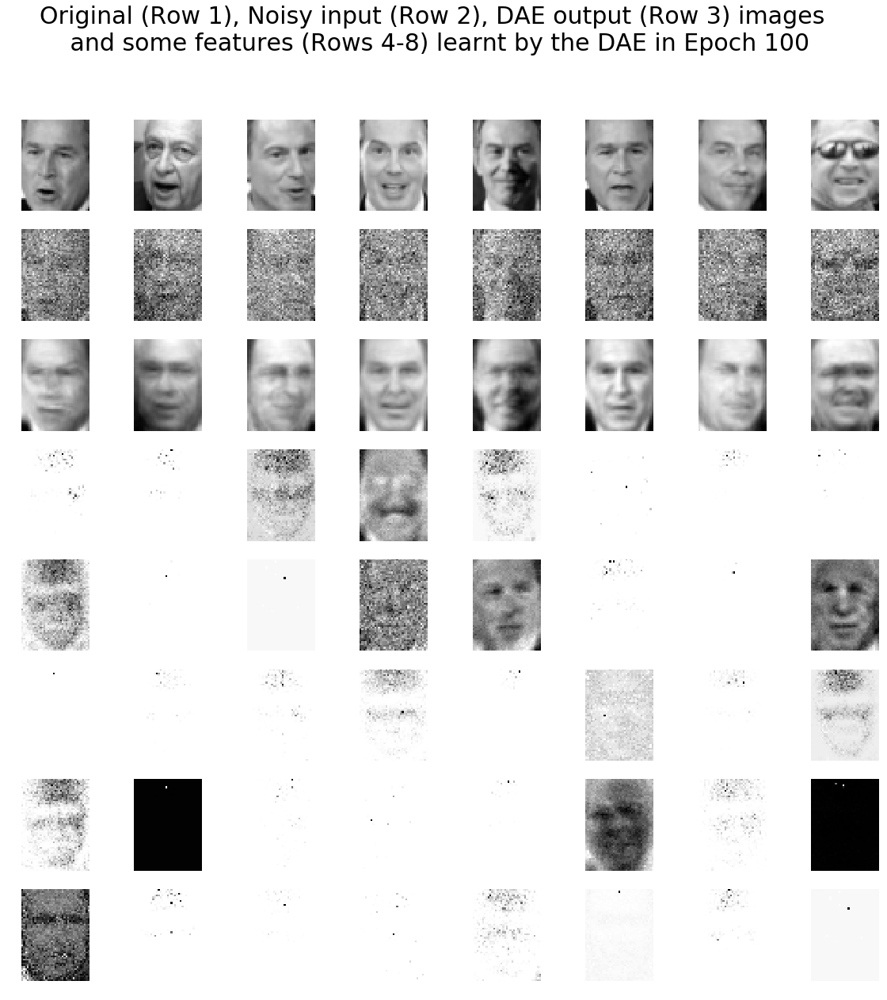

In [5]:
import os
import numpy as np
import matplotlib.pylab as plt

import torch
from torch import nn
from torch.autograd import Variable
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.utils import save_image
from torchviz import make_dot

from sklearn.datasets import fetch_lfw_people

#print(torch.cuda.current_device())
#print(torch.cuda.device(0))
#print(torch.cuda.device_count())
#print(torch.cuda.get_device_name(0))

def to_img(x):
    x = x.view(x.size(0), 1, 50, 37)
    return x

num_epochs = 100 #100
batch_size = 8 # 16
learning_rate = 1e-3
cuda = False #True 


def add_noise(img):
    noise = torch.randn(img.size()) * 0.2
    noisy_img = img + noise
    return noisy_img


def plot_sample_img(img, name):
    img = img.view(1, 50, 37)
    save_image(img, './sample_{}.png'.format(name))


def min_max_normalization(tensor, min_value, max_value):
    min_tensor = tensor.min()
    tensor = (tensor - min_tensor)
    max_tensor = tensor.max()
    tensor = tensor / max_tensor
    tensor = tensor * (max_value - min_value) + min_value
    return tensor


def tensor_round(tensor):
    return torch.round(tensor)


img_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Lambda(lambda tensor:min_max_normalization(tensor, 0, 1)),
    transforms.Lambda(lambda tensor:tensor_round(tensor))
])

dataset = fetch_lfw_people(min_faces_per_person=70, resize=0.4).images / 255
print(dataset.shape)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

class autoencoder(nn.Module):
    def __init__(self):
        super(autoencoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Linear(50 * 37, 512),
            nn.ReLU(True),
            nn.Linear(512, 128),
            nn.ReLU(True))
        self.decoder = nn.Sequential(
            nn.Linear(128, 512),
            nn.ReLU(True),
            nn.Linear(512, 50 * 37),
            nn.Sigmoid())

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

model = autoencoder()
if cuda:
    model = model.cuda()
criterion = nn.BCELoss()
optimizer = torch.optim.Adam(
    model.parameters(), lr=learning_rate, weight_decay=1e-5)

for epoch in range(1, num_epochs+1):
    for data in dataloader:
        #img, _ = data
        img = data
        img = img.view(img.size(0), -1)
        noisy_img = add_noise(img)
        noisy_img = Variable(noisy_img)
        if cuda:
            noisy_img = noisy_img.cuda()
        img = Variable(img)
        if cuda:
            img = img.cuda()
        # ===================forward=====================
        output = model(noisy_img)
        loss = criterion(output, img)
        MSE_loss = nn.MSELoss()(output, img)
        # ===================backward====================
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
    # ===================log========================
    print('epoch [{}/{}], loss:{:.4f}, MSE_loss:{:.4f}'
          .format(epoch, num_epochs, loss.data.item(), MSE_loss.data.item()))
    if epoch % 10 == 0:
        x = to_img(img.cpu().data)
        x_hat = to_img(output.cpu().data)
        x_noisy = to_img(noisy_img.cpu().data)
        weights = to_img(model.encoder[0].weight.cpu().data)
        plt.figure(figsize=(20,20))
        plt.gray()
        for i in range(8):
            plt.subplot(8,8,i+1), plt.imshow(x.data.numpy()[i,0,...]), plt.axis('off')
        for i in range(8):
            plt.subplot(8,8,i+9), plt.imshow(x_noisy.data.numpy()[i,0,...]), plt.axis('off')
        for i in range(8):
            plt.subplot(8,8,i+17), plt.imshow(x_hat.data.numpy()[i,0,...]), plt.axis('off')
        indices = np.random.choice(512, 40)
        for i in range(40):
            plt.subplot(8,8,i+25), plt.imshow(weights.data.numpy()[indices[i],0,...]), plt.axis('off')
        plt.suptitle('Original (Row 1), Noisy input (Row 2), DAE output (Row 3) images \n and some features (Rows 4-8) learnt by the DAE in Epoch {}'.format(epoch), size=30)
        plt.show()
        #print(weights.shape)

#torch.save(model.state_dict(), './sim_dautoencoder.pth')

In [32]:
print(model)

autoencoder(
  (encoder): Sequential(
    (0): Linear(in_features=1850, out_features=512, bias=True)
    (1): ReLU(inplace)
    (2): Linear(in_features=512, out_features=128, bias=True)
    (3): ReLU(inplace)
  )
  (decoder): Sequential(
    (0): Linear(in_features=128, out_features=512, bias=True)
    (1): ReLU(inplace)
    (2): Linear(in_features=512, out_features=1850, bias=True)
    (3): Sigmoid()
  )
)


### Image Denoising with Principal Component Analysis (PCA), Discrete Fourier / Wavelet Tranform (FFT, DWT)

(400, 4096)
Extracting the top 50 PCs...
done in 0.136s


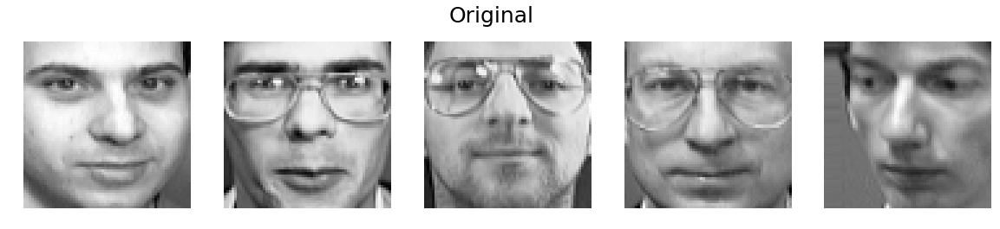

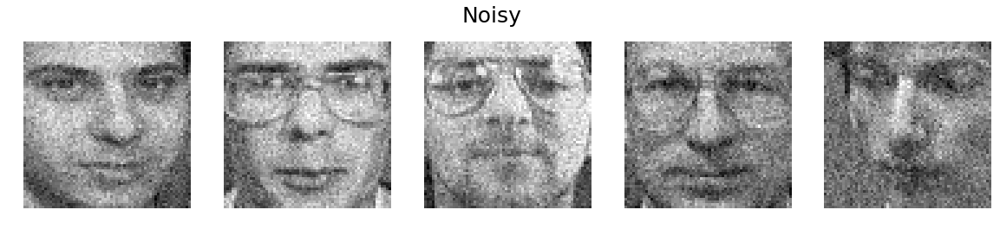

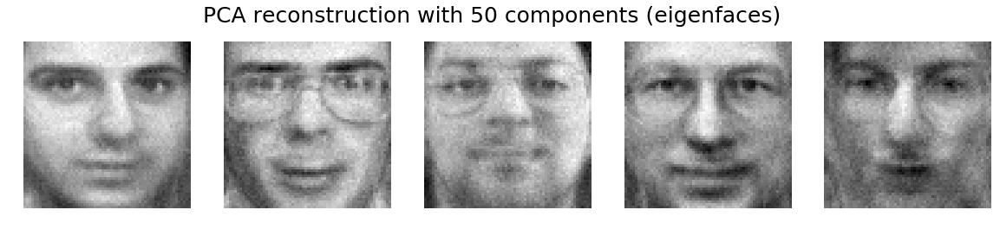

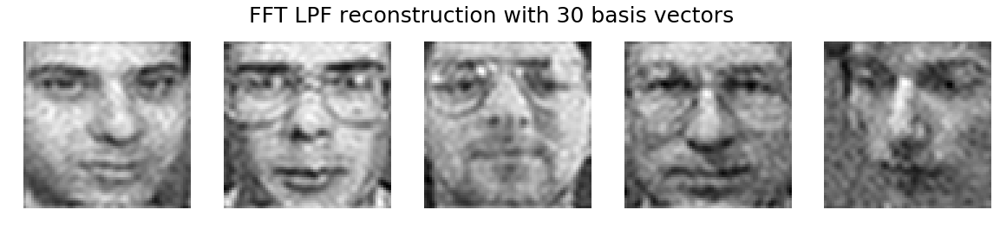

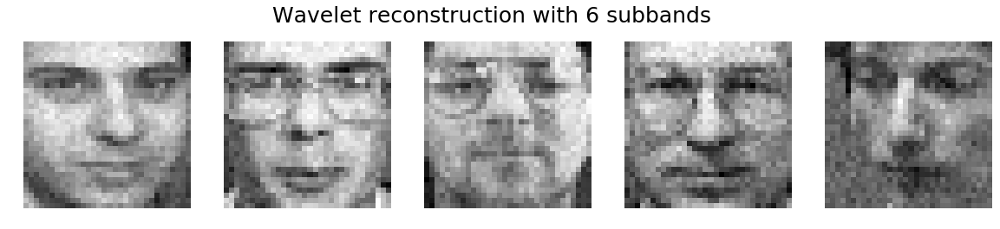

In [128]:
import numpy as np
from numpy.random import RandomState
import matplotlib.pyplot as plt
from sklearn.datasets import fetch_olivetti_faces
from sklearn import decomposition
from skimage.util import random_noise
from skimage import img_as_float
from time import time
import scipy.fftpack as fp
import pywt

n_components = 50 # 256
image_shape = (64, 64)
rng = RandomState(0)

dataset = fetch_olivetti_faces(shuffle=True, random_state=rng)
original = img_as_float(dataset.data)
faces = original.copy()
print(faces.shape)

n_samples, n_features = faces.shape
#mean_face = faces.mean(axis=0)
#faces = faces - mean_face
faces = random_noise(faces, var=0.005)

estimator = decomposition.PCA(n_components=n_components, svd_solver='randomized', whiten=True)
print("Extracting the top %d PCs..." % (n_components))
t0 = time()
faces_recons = estimator.inverse_transform(estimator.fit_transform(faces)) #.T #+ mean_face #.T
train_time = (time() - t0)
print("done in %0.3fs" % train_time)

indices = np.random.choice(n_samples, 5, replace=False)
plt.figure(figsize=(20,4))
for i in range(len(indices)):
    plt.subplot(1,5,i+1), plt.imshow(np.reshape(original[indices[i],:], image_shape)), plt.axis('off')
plt.suptitle('Original', size=25)
plt.show()

#faces = faces + mean_face
plt.figure(figsize=(20,4))
for i in range(len(indices)):
    plt.subplot(1,5,i+1), plt.imshow(np.reshape(faces[indices[i],:], image_shape)), plt.axis('off')
plt.suptitle('Noisy', size=25)
plt.show()

plt.figure(figsize=(20,4))
for i in range(len(indices)):
    plt.subplot(1,5,i+1), plt.imshow(np.reshape(faces_recons[indices[i],:], image_shape)), plt.axis('off')
plt.suptitle('PCA reconstruction with {} components (eigenfaces)'.format(n_components), size=25)
plt.show()

n_components = 30 
plt.figure(figsize=(20,4))
for i in range(len(indices)):
    freq = fp.fftshift(fp.fft2((np.reshape(faces[indices[i],:], image_shape)).astype(float)))
    freq[:freq.shape[0]//2 - n_components//2,:] = freq[freq.shape[0]//2 + n_components//2:,:] = 0
    freq[:, :freq.shape[1]//2 - n_components//2] = freq[:, freq.shape[1]//2 + n_components//2:] = 0
    plt.subplot(1,5,i+1), plt.imshow(fp.ifft2(fp.ifftshift(freq)).real), plt.axis('off')
plt.suptitle('FFT LPF reconstruction with {} basis vectors'.format(n_components), size=25)
plt.show()

plt.figure(figsize=(20,4))
wavelet = pywt.Wavelet('haar')
for i in range(len(indices)):
    wavelet_coeffs = pywt.wavedec2((np.reshape(faces[indices[i],:], image_shape)).astype(float), wavelet)
    plt.subplot(1,5,i+1), plt.imshow(pywt.waverec2(wavelet_coeffs[:-1], wavelet)), plt.axis('off')
plt.suptitle('Wavelet reconstruction with {} subbands'.format(len(wavelet_coeffs)-1), size=25)
plt.show()

### Pyramid Blending 

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\skimage\transform\_warps.py:24: UserWarning: The default multichannel argument (None) is deprecated.  Please specify either True or False explicitly.  multichannel will default to False starting with release 0.16.
  warn('The default multichannel argument (None) is deprecated.  Please '
C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


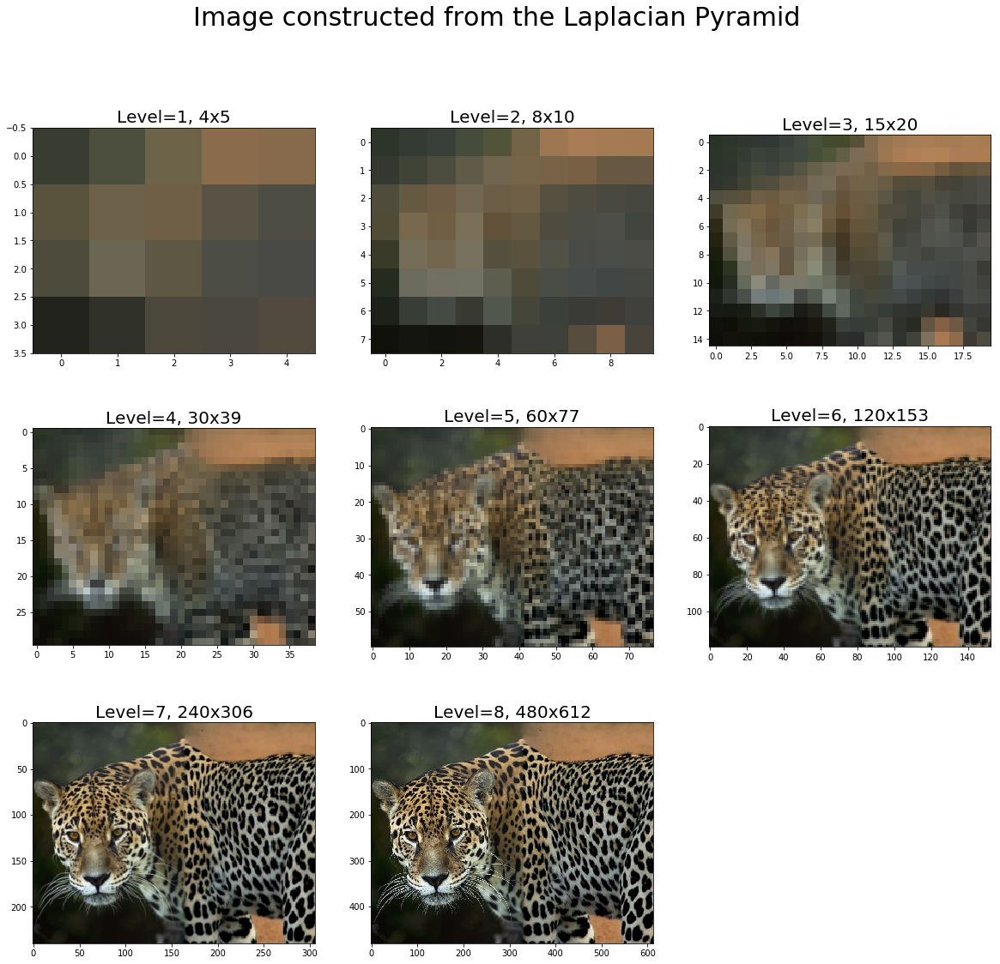

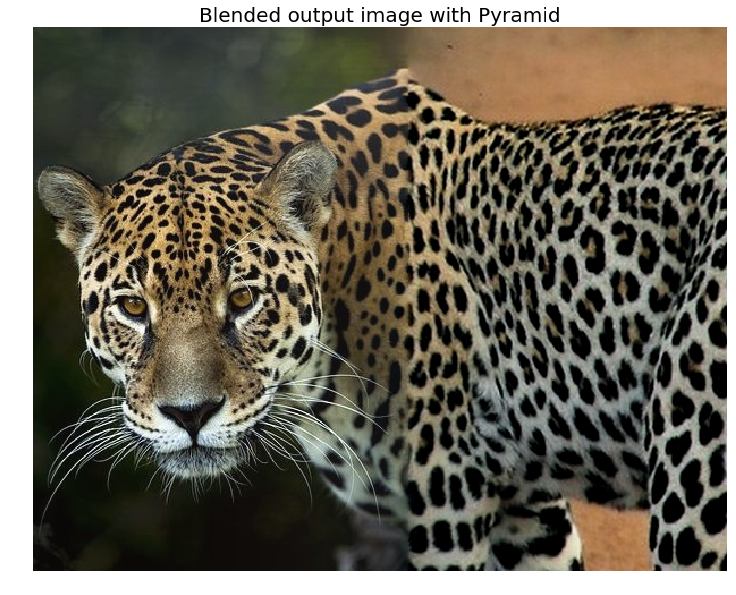

In [10]:
import numpy as np
import matplotlib.pyplot as plt

from skimage.io import imread
from skimage.color import rgb2gray
from skimage.transform import pyramid_reduce, pyramid_laplacian, pyramid_expand, resize

def get_gaussian_pyramid(image):
    rows, cols, dim = image.shape
    gaussian_pyramid = [image]
    while rows > 1 and cols > 1:
        #print(rows, cols)
        image = pyramid_reduce(image, downscale=2)
        gaussian_pyramid.append(image)
        #print(image.shape)
        rows //= 2
        cols //= 2
    return gaussian_pyramid

def get_laplacian_pyramid(gaussian_pyramid):
    laplacian_pyramid = [gaussian_pyramid[len(gaussian_pyramid)-1]]
    for i in range(len(gaussian_pyramid)-2, -1, -1):
        image = gaussian_pyramid[i] - resize(pyramid_expand(gaussian_pyramid[i+1]), gaussian_pyramid[i].shape)
        #print(i, image.shape)
        laplacian_pyramid.append(np.copy(image))
    laplacian_pyramid = laplacian_pyramid[::-1]
    return laplacian_pyramid

def reconstruct_image_from_laplacian_pyramid(pyramid):
    i = len(pyramid) - 2
    prev = pyramid[i+1]
    plt.figure(figsize=(20,18))
    j = 1
    while i >= 0:
        prev = resize(pyramid_expand(prev, upscale=2), pyramid[i].shape)
        im = np.clip(pyramid[i] + prev,0,1)
        plt.subplot(3,3,j)
        plt.imshow(im)
        plt.title('Level=' + str(j) + ', ' + str(im.shape[0]) + 'x' + str(im.shape[1]), size=20)
        prev = im
        i -= 1
        j += 1
    plt.suptitle('Image constructed from the Laplacian Pyramid', size=30)
    plt.show()
    return im

A = imread('images/jaguar.jpg')[...,:3] / 255
B = imread('images/leopard.jpg')[...,:3] / 255
M = imread('images/pmask.png')[...,:3] / 255

rows, cols, dim = A.shape
pyramidA = get_laplacian_pyramid(get_gaussian_pyramid(A))
pyramidB = get_laplacian_pyramid(get_gaussian_pyramid(B))
pyramidM = get_gaussian_pyramid(M)

pyramidC = []
for i in range(len(pyramidM)):
    im = pyramidM[i]*pyramidA[i] + (1-pyramidM[i])*pyramidB[i]
    #print(np.max(im), np.min(im), np.mean(im))
    pyramidC.append(im)

im = reconstruct_image_from_laplacian_pyramid(pyramidC)

plt.figure(figsize=(20,10))
plt.imshow(im), plt.axis('off'), plt.title('Blended output image with Pyramid', size=20)
plt.show()

### Gradient Blending

In [12]:
import cv2
print(cv2.__version__) # make sure the major version of OpenCV is 3
# 3.4.2
import numpy as np
# read source and destination images
src = cv2.imread("images/liberty.jpg")
dst = cv2.imread("images/victoria.jpg")
# read the mask image
src_mask = cv2.imread("images/cmask.jpg")
print(src.shape, dst.shape, src_mask.shape)
# (480, 698, 3) (576, 768, 3) (480, 698, 3)
# this is where the CENTER of the airplane will be placed
center = (325,225)
# clone seamlessly.
output = cv2.seamlessClone(src, dst, src_mask, center, cv2.MIXED_CLONE)
# save result
cv2.imwrite("images/liberty_victoria.jpg", output)

3.4.2
(480, 360, 3) (540, 720, 3) (480, 360, 3)


True

![](images/liberty_victoria.jpg)

### Improving Image Contrast

C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\ipykernel_launcher.py:15: VisibleDeprecationWarning: Passing `normed=True` on non-uniform bins has always been broken, and computes neither the probability density function nor the probability mass function. The result is only correct if the bins are uniform, when density=True will produce the same result anyway. The argument will be removed in a future version of numpy.
  from ipykernel import kernelapp as app
C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\skimage\exposure\exposure.py:63: UserWarning: This might be a color image. The histogram will be computed on the flattened image. You can instead apply this function to each color channel.
  warn("This might be a color image. The histogram will be "
C:\Users\Sandipan.Dey\Anaconda\envs\ana41py35\lib\site-packages\skimage\util\dtype.py:141: UserWarning: Possible precision loss when converting from float64 to uint16
  .format(dtypeobj_in, dtypeobj_out))


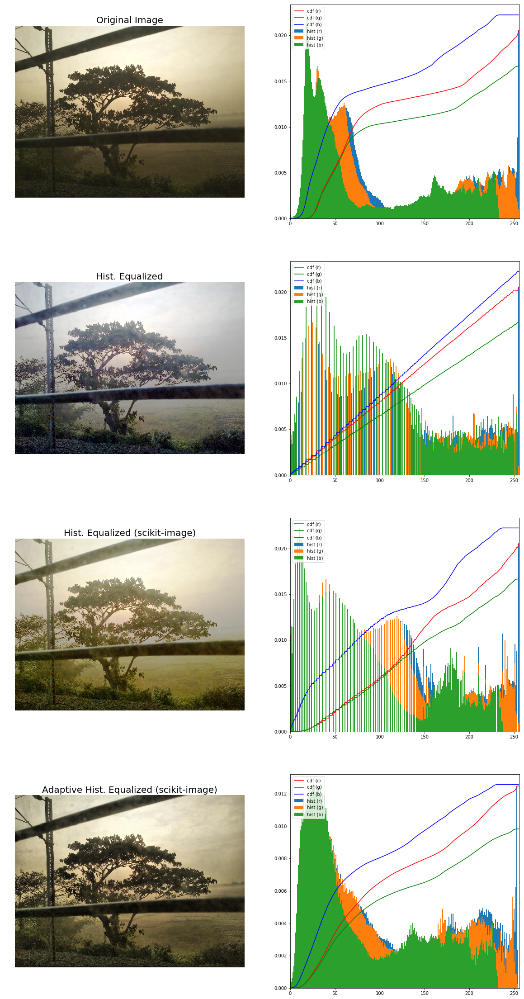

In [45]:
import numpy as np
import matplotlib.pylab as plt
from skimage.io import imread
from skimage.exposure import equalize_hist, equalize_adapthist

def plot_image(image, title):
    plt.imshow(image)
    plt.title(title, size=20)
    plt.axis('off')
    
def plot_hist(img):
    colors = ['r', 'g', 'b']
    cdf = np.zeros((256,3))
    for i in range(3):
        hist, bins = np.histogram(img[...,i].flatten(),256,[0,256], normed=True)
        cdf[...,i] = hist.cumsum()
        cdf_normalized = cdf[...,i] * hist.max() / cdf.max()
        plt.plot(cdf_normalized, color = colors[i], label='cdf ({})'.format(colors[i]))
        #plt.hist(img[...,i].flatten(),256,[0,256], color = colors[i], density=True)
        binWidth = bins[1] - bins[0]
        plt.bar(bins[:-1], hist*binWidth, binWidth, label='hist ({})'.format(colors[i]))
        plt.xlim([0,256])
    plt.legend(loc = 'upper left')
    return cdf

img = imread('images/train.jpg')
#print(np.max(img))

plt.figure(figsize=(20,40))
#plt.gray()

plt.subplot(421), plot_image(img, 'Original Image')
plt.subplot(422) 
cdf = plot_hist(img)

img2 = np.copy(img)
for i in range(3):
    cdf_m = np.ma.masked_equal(cdf[...,i],0)
    cdf_m = (cdf_m - cdf_m.min())*255/(cdf_m.max()-cdf_m.min())
    #cdf_m = 255 * cdf / cdf[-1] # normalize
    cdf2 = np.ma.filled(cdf_m,0).astype('uint8')
    img2[...,i] = cdf2[img[...,i]]

plt.subplot(423), plot_image(img2, 'Hist. Equalized')
plt.subplot(424), plot_hist(img2)

equ = (255*equalize_hist(img)).astype(np.uint8)
plt.subplot(425), plot_image(equ, 'Hist. Equalized (scikit-image)')
plt.subplot(426), plot_hist(equ)


equ = (255*equalize_adapthist(img)).astype(np.uint8)
plt.subplot(427), plot_image(equ, 'Adaptive Hist. Equalized (scikit-image)')
plt.subplot(428), plot_hist(equ)

plt.savefig('images/hist_out.png', bbox_in='tight', pad_in=0)

plt.show()

### Sharpening Image

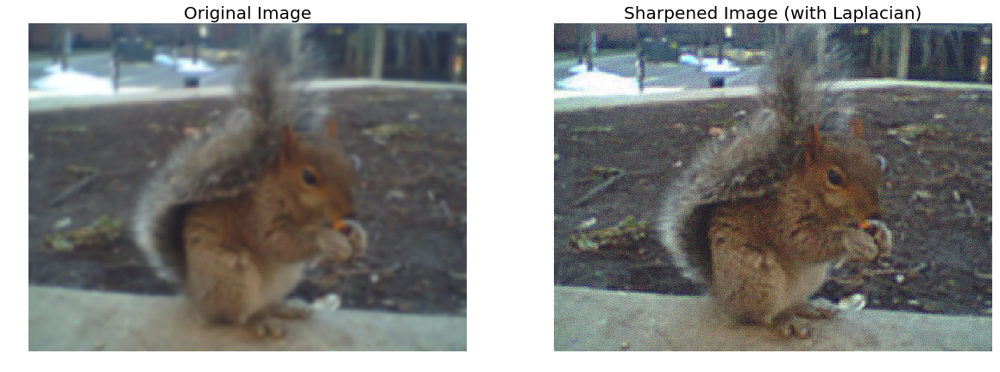

In [9]:
import SimpleITK as sitk
import sys, os
import matplotlib.pylab as plt

reader = sitk.ImageFileReader()
reader.SetFileName ('images/squirrel.jpg')
image = reader.Execute()
plt.figure(figsize=(20,10))
plt.subplot(121), plt.imshow(sitk.GetArrayFromImage(image)), plt.axis('off'), plt.title('Original Image', size=20)
pixelID = image.GetPixelID()
laplacian = sitk.LaplacianSharpeningImageFilter() 
#laplacian.SetSigma(5)
image = laplacian.Execute ( image )
caster = sitk.CastImageFilter()
caster.SetOutputPixelType( pixelID )
image = caster.Execute( image )
plt.subplot(122), plt.imshow(sitk.GetArrayFromImage(image)), plt.axis('off'), plt.title('Sharpened Image (with Laplacian)', size=20)
plt.show()
writer = sitk.ImageFileWriter()
writer.SetFileName ('images/squirrel_out.jpg')
writer.Execute ( image )

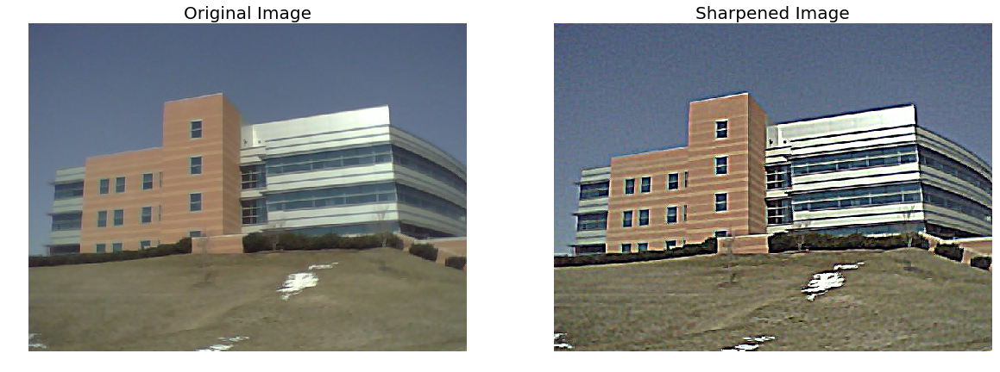

In [44]:
import cv2

im = cv2.imread("images/umbc.jpg")
im_blurred = cv2.GaussianBlur(im, (11,11), 10)
im1 = cv2.addWeighted(im, 1.0 + 3.0, im_blurred, -3.0, 0) # im1 = im + 3.0*(im - im_blurred)
plt.figure(figsize=(20,10))
plt.subplot(121),plt.imshow(cv2.cvtColor(im, cv2.COLOR_BGR2RGB)), plt.axis('off'), plt.title('Original Image', size=20)
plt.subplot(122),plt.imshow(cv2.cvtColor(im1, cv2.COLOR_BGR2RGB)), plt.axis('off'), plt.title('Sharpened Image', size=20)
plt.show()

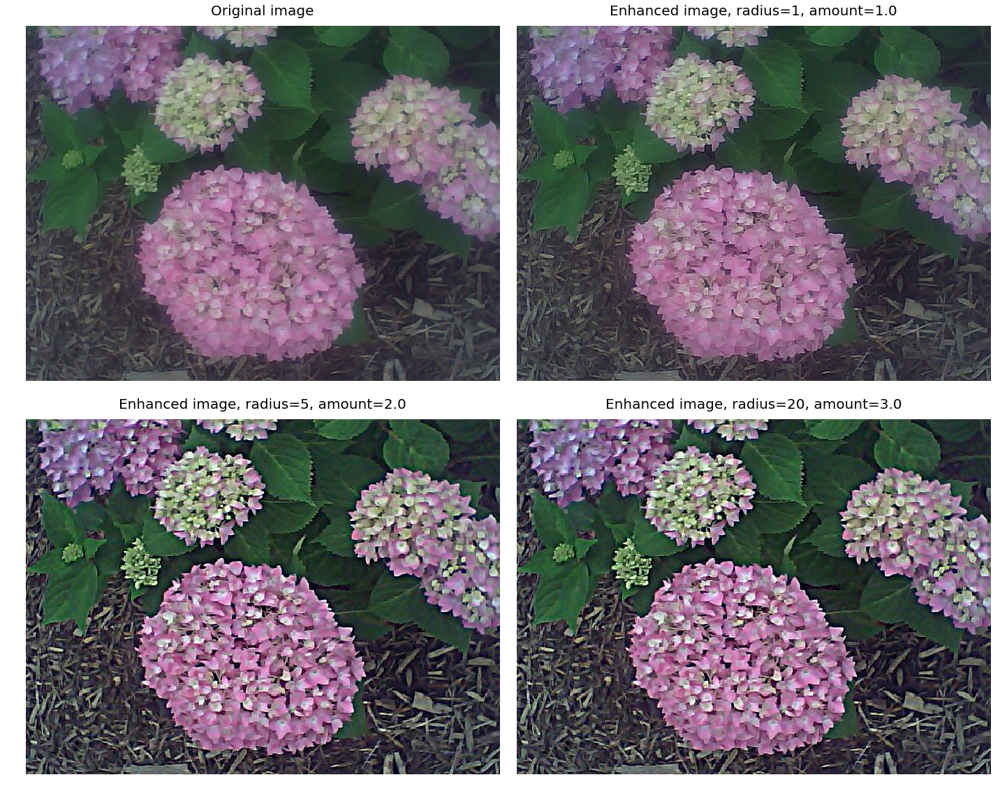

In [22]:
#!pip install -U scikit-image
#print(skimage.filters.__all__)
import numpy as np
import matplotlib.pylab as plt
from skimage.io import imread
from skimage.filters import unsharp_mask
im = imread('images/flowers.jpg')
fig, axes = plt.subplots(nrows=2, ncols=2, sharex=True, sharey=True, figsize=(20, 16))
axes = axes.ravel()
axes[0].set_title('Original image', size=20)
axes[0].imshow(im, cmap=plt.cm.gray)
im1 = np.copy(im).astype(np.float)
for i in range(3):
    im1[...,i] = unsharp_mask(im[...,i], radius=1, amount=1)
axes[1].set_title('Enhanced image, radius=1, amount=1.0', size=20)
axes[1].imshow(im1, cmap=plt.cm.gray)
for i in range(3):
    im1[...,i] = unsharp_mask(im[...,i], radius=5, amount=2)
axes[2].set_title('Enhanced image, radius=5, amount=2.0', size=20)
axes[2].imshow(im1, cmap=plt.cm.gray)
for i in range(3):
    im1[...,i] = unsharp_mask(im[...,i], radius=5, amount=2)
axes[3].set_title('Enhanced image, radius=20, amount=3.0', size=20)
axes[3].imshow(im1, cmap=plt.cm.gray)
for ax in axes:
 ax.axis('off')
fig.tight_layout()
#plt.savefig('images/unsharp_skimage.png', bbox_in='tight', pad_in=0)
plt.show()

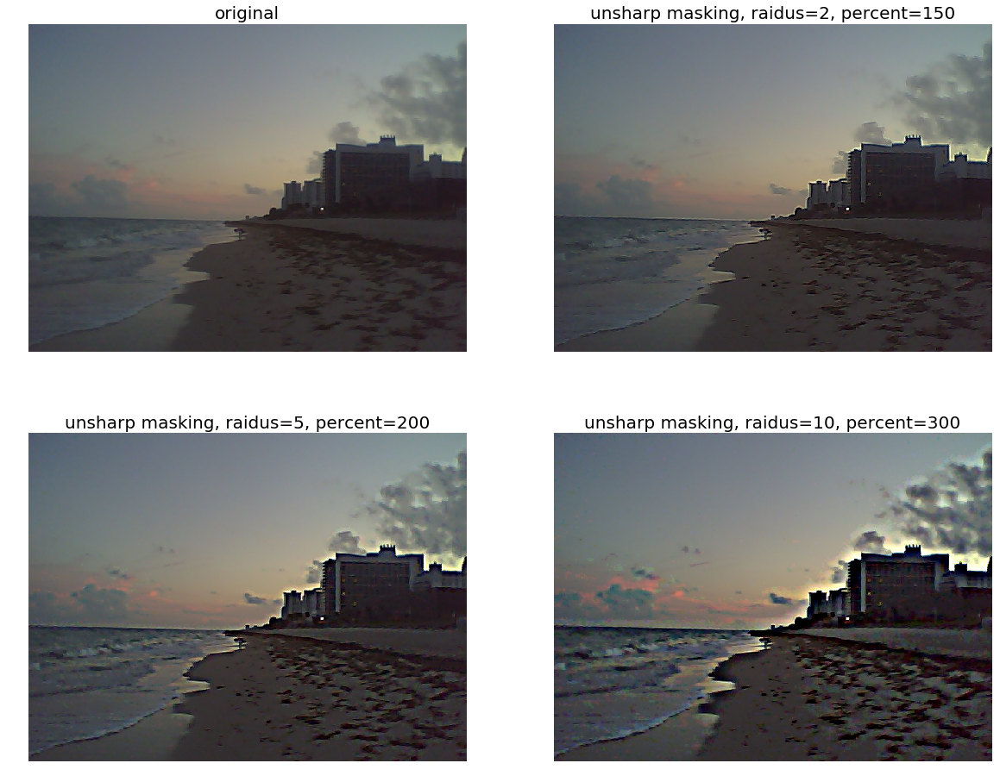

In [9]:
from PIL import Image, ImageFilter

def plot_image(image, title):
    plt.imshow(image)
    plt.title(title, size=20)
    plt.axis('off')

im = Image.open('images/beach.jpg')
plt.figure(figsize=(20,16))
plt.subplot(221), plot_image(im, 'original')
im1 = im.filter(ImageFilter.UnsharpMask(radius=2, percent=150))
plt.subplot(222), plot_image(im1, 'unsharp masking, raidus=2, percent=150')
im1 = im.filter(ImageFilter.UnsharpMask(radius=5, percent=200))
plt.subplot(223), plot_image(im1, 'unsharp masking, raidus=5, percent=200')
im1 = im.filter(ImageFilter.UnsharpMask(radius=10, percent=300))
plt.subplot(224), plot_image(im1, 'unsharp masking, raidus=10, percent=300')
plt.show()

### Mean/Median Filter to remove different type of Noise

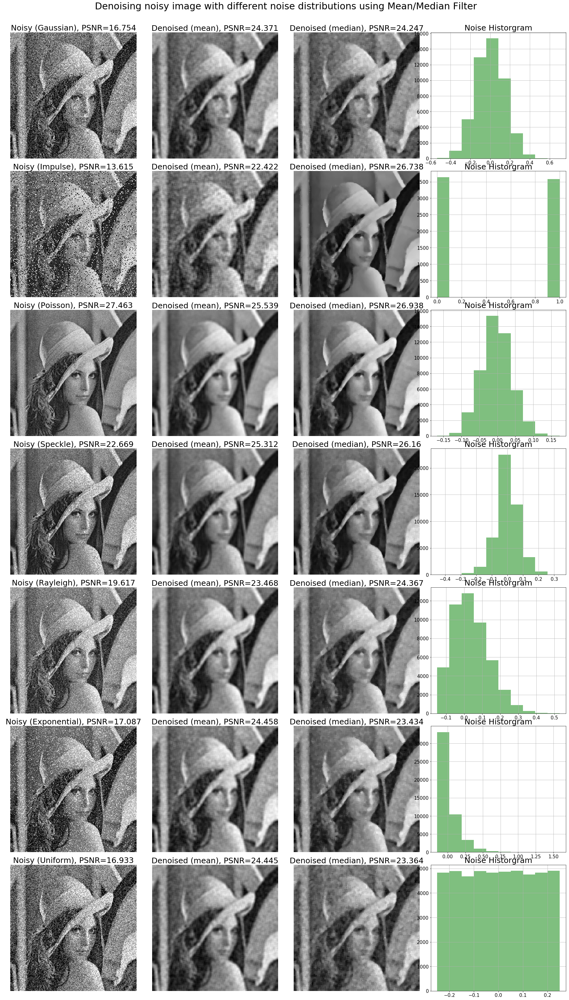

In [21]:
% matplotlib inline
from skimage.io import imread
from skimage.util import random_noise
from skimage.color import rgb2gray
from scipy.ndimage import uniform_filter, median_filter
from skimage.measure import compare_psnr
import numpy as np
import matplotlib.pylab as plt

def plt_hist(noise, bins=None):
    plt.grid()
    plt.hist(np.ravel(noise), bins=bins, alpha=0.5, color='green')
    plt.tick_params(labelsize=15)
    plt.title('Noise Historgram', size=25)

def plt_images(im, im_noisy, noise, noise_type, i):
    im_denoised_mean = uniform_filter(im_noisy, 5)
    im_denoised_median = median_filter(im_noisy, 5)
    plt.subplot(7,4,i), plt.imshow(im_noisy), plt.title('Noisy ({}), PSNR={}'.format(noise_type, np.round(compare_psnr(im, im_noisy),3)), size=25), plt.axis('off')
    plt.subplot(7,4,i+1), plt.imshow(im_denoised_mean), plt.title('Denoised (mean), PSNR={}'.format(np.round(compare_psnr(im, im_denoised_mean),3)), size=25), plt.axis('off')
    plt.subplot(7,4,i+2), plt.imshow(im_denoised_median), plt.title('Denoised (median), PSNR={}'.format(np.round(compare_psnr(im, im_denoised_median),3)), size=25), plt.axis('off')
    plt.subplot(7,4,i+3), plt_hist(noise)

im = rgb2gray(imread('images/lena.jpg'))

plt.figure(figsize=(25,45))
plt.subplots_adjust(left=0, top=0.95, right=1, bottom=0, wspace=0.05, hspace=0.1)
plt.gray()

im1 = random_noise(im, 'gaussian', var=0.15**2)
plt_images(im, im1, im1-im, 'Gaussian', 1)

im1 = random_noise(im, 's&p', amount=0.15)
plt_images(im, im1, im1[((im1==0)|(im1==1))&((im!=0)&(im!=1))], 'Impulse', 5)

#im1 = random_noise(im, 'poisson', clip=True)
#im1 = np.clip(np.random.poisson(lam=255*im, size=None)/255, 0, 1)
noise = np.random.poisson(lam=int(np.mean(255*im)), size=im.shape)/255 - np.mean(im)
im1 = np.clip(im + noise, 0, 1)
plt_images(im, im1, noise, 'Poisson', 9)

im1 = random_noise(im, 'speckle', var=0.15**2)
plt_images(im, im1, im1-im, 'Speckle', 13)

noise = np.random.rayleigh(scale=0.15, size=im.shape) - 0.15
im1 = np.clip(im + noise, 0, 1)
plt_images(im, im1, noise, 'Rayleigh', 17)

#im1 = np.clip(np.random.exponential(scale=im, size=None), 0, 1)
noise = np.random.exponential(scale=0.15, size=im.shape) - 0.15
im1 = np.clip(im + noise, 0, 1)
plt_images(im, im1, noise, 'Exponential', 21)

noise = np.random.uniform(0, 0.5, size=im.shape) - 0.25
im1 = np.clip(im + noise, 0, 1)
plt_images(im, im1, noise, 'Uniform', 25)

plt.suptitle('Denoising noisy image with different noise distributions using Mean/Median Filter', size=30)
plt.savefig('images/median_noisetype.png', bbox_in='tight', pad_in=0)
plt.show()

### Median Filter with different kernel size to remove Salt & Pepper Noise

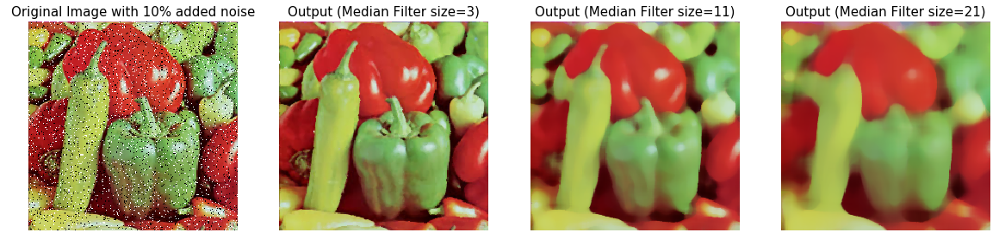

In [9]:
from PIL import Image, ImageFilter
import numpy as np

im = Image.open('images/pepper.jpg')

prop_noise = 0.1
n = int(im.width * im.height * prop_noise)
x, y = np.random.randint(0, im.width, n), np.random.randint(0, im.height, n)
for (x,y) in zip(x,y):
  im.putpixel((x, y), ((0,0,0) if np.random.rand() < 0.5 else (255,255,255))) # geenrate salt-and-pepper noise

plt.figure(figsize=(20,5))
plt.subplot(1,4,1)
plt.imshow(im)
plt.title('Original Image with ' + str(int(100*prop_noise)) + '% added noise', size=15)
plt.axis('off')
i = 2
for sz in [3,11,21]:
 im1 = im.filter(ImageFilter.MedianFilter(size=sz)) 
 plt.subplot(1,4,i),  
 plt.imshow(im1) 
 plt.title('Output (Median Filter size=' + str(sz) + ')', size=15) # Mode Median
 plt.axis('off')
 i += 1
plt.show()

### Percentile Filter to remove impulse (s&p) noise

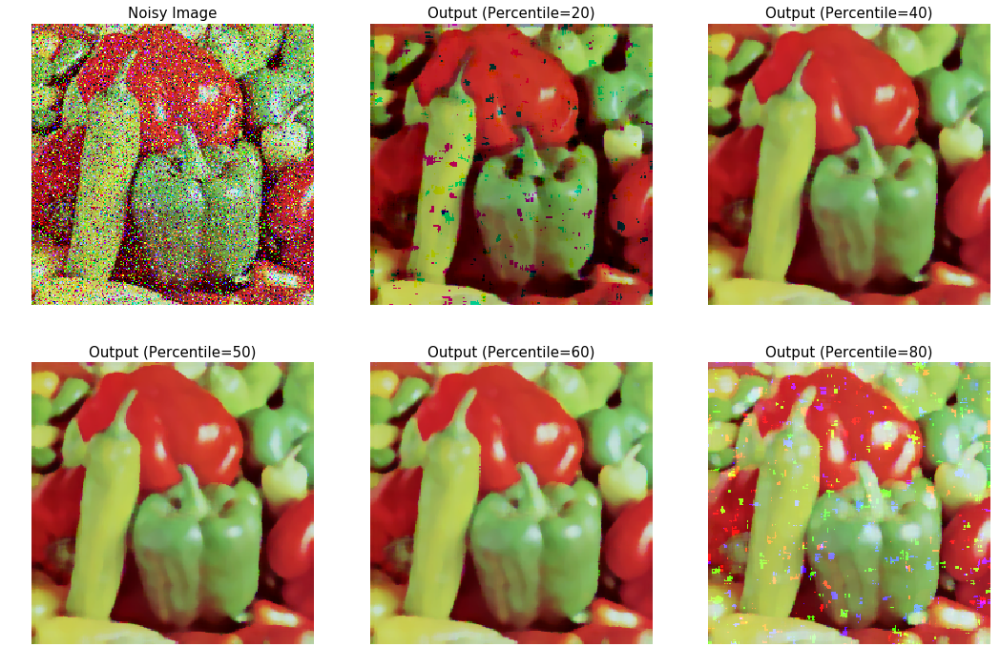

In [4]:
from scipy.ndimage import percentile_filter
from skimage.io import imread
from skimage.util import random_noise
import matplotlib.pylab as plt

im = imread('images/pepper.jpg')
im = random_noise(im, 's&p', amount=0.2)

plt.figure(figsize=(18,12))
plt.subplot(2,3,1)
plt.imshow(im)
plt.title('Noisy Image', size=15)
plt.axis('off')
i = 2
for p in [20, 40, 50, 60, 80]:
 im1 = percentile_filter(im, p, size=(7,7,1)) 
 #im1 = np.clip(im1, 0, 1)
 plt.subplot(2,3,i)  
 plt.imshow(im1) 
 plt.title('Output (Percentile={})'.format(p), size=15) # Mode Median
 plt.axis('off')
 i += 1
plt.show()

### Bilateral Filter

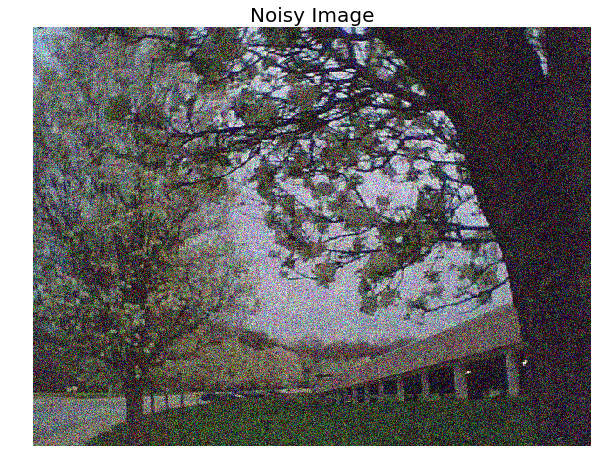

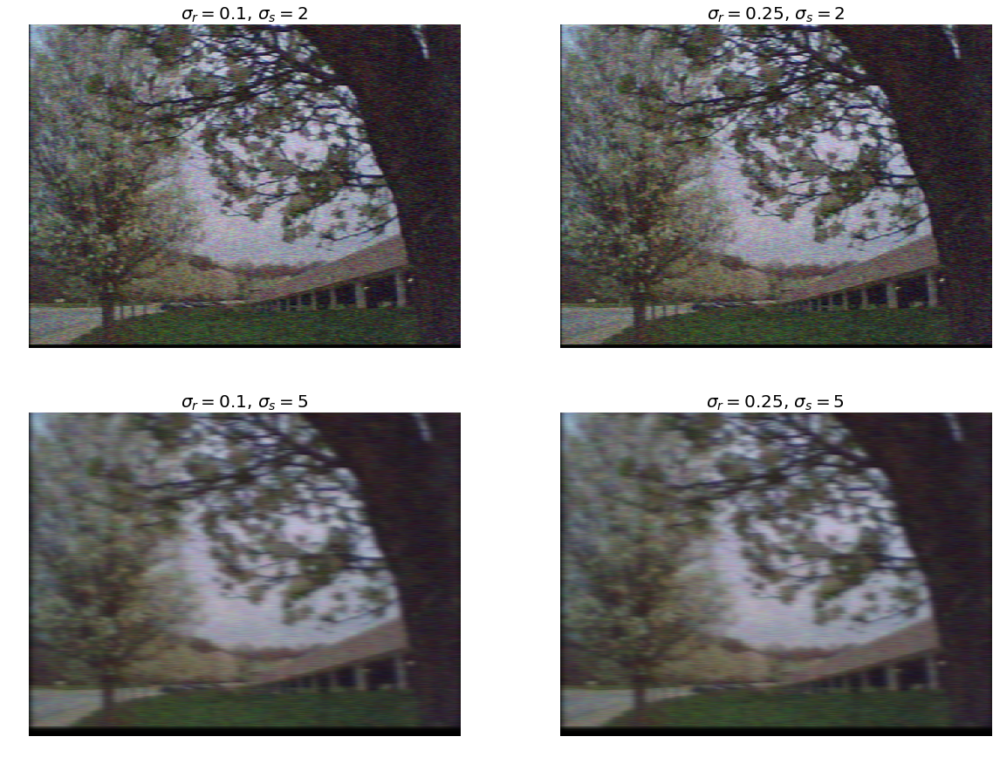

In [10]:
from skimage.restoration import denoise_bilateral, denoise_nl_means, estimate_sigma

im = imread('images/trees.jpg')
sigma = 0.15
noisy = random_noise(im, var=sigma**2)
plt.figure(figsize=(10,10))
plt.imshow(noisy), plt.axis('off'), plt.title('Noisy Image', size=20)
plt.show()
plt.figure(figsize=(20,15))
i = 1
for sigma_sp in [2, 5]:
    for sigma_col in [0.1, 0.25]:
        plt.subplot(2,2,i)
        plt.imshow(denoise_bilateral(noisy, sigma_color=sigma_col, sigma_spatial=sigma_sp, bins=100, multichannel=True))
        plt.axis('off')
        plt.title(r'$\sigma_r=$' + str(sigma_col) + r', $\sigma_s=$' + str(sigma_sp), size=20)
        i += 1
plt.show()

### Non-local Means Filter

estimated noise standard deviation = 0.2292765358032878
PSNR (noisy) = 12.88
PSNR (slow) = 22.20
PSNR (fast) = 23.96


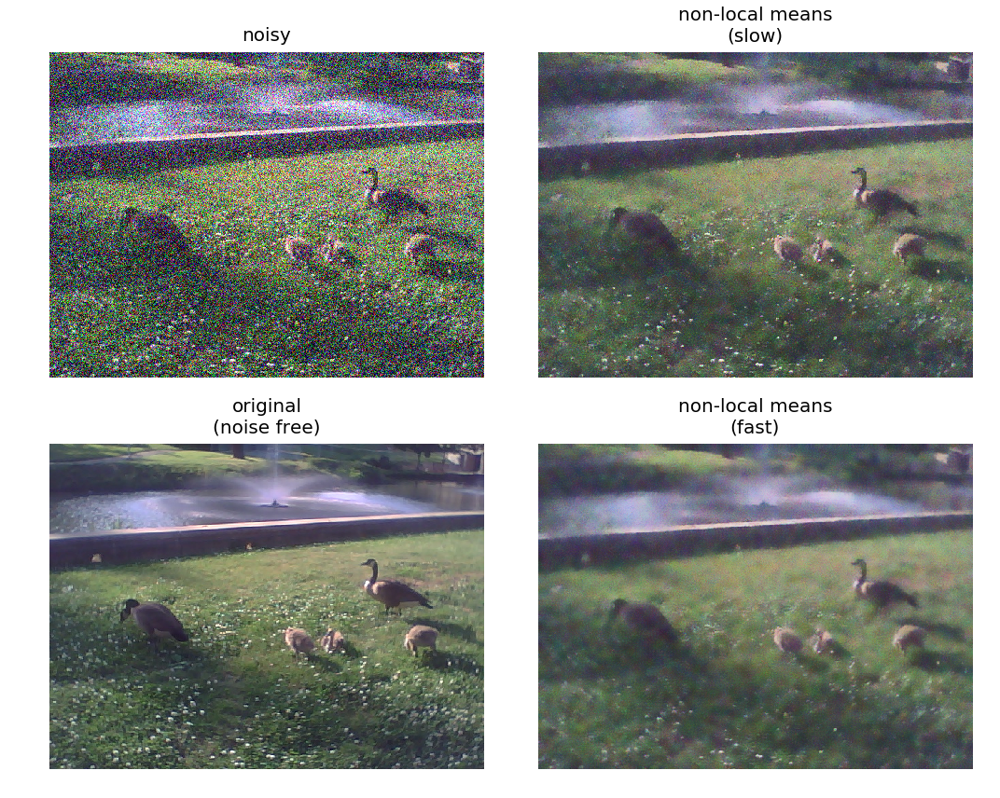

In [12]:
#! pip uninstall pywt
#! pip install pywavelets
import numpy as np
from skimage import img_as_float
from skimage.io import imread
from skimage.restoration import denoise_bilateral, denoise_nl_means, estimate_sigma
from skimage.measure import compare_psnr
import matplotlib.pylab as plt

def plot_image_axes(image, axes, title):
    axes.imshow(image)
    axes.axis('off')
    axes.set_title(title, size=20)
    
im = img_as_float(imread('images/ducks.jpg'))
sigma = 0.25
noisy = im + sigma * np.random.standard_normal(im.shape)
noisy = np.clip(noisy, 0, 1)
# you can estimate the noise standard deviation from the noisy image using the estimate_sigma function
sigma_est = np.mean(estimate_sigma(noisy, multichannel=True))
print("estimated noise standard deviation = {}".format(sigma_est))
patch_kw = dict(patch_size=5, # 5x5 patches
patch_distance=6, # 13x13 search area
multichannel=True)
# slow algorithm
denoise = denoise_nl_means(noisy, h=0.8*sigma_est, fast_mode=False, **patch_kw)
# fast algorithm
denoise_fast = denoise_nl_means(noisy, h=0.8*sigma_est, fast_mode=True, **patch_kw)
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(15, 12), sharex=True, sharey=True)
plot_image_axes(noisy, axes[0, 0], 'noisy')
plot_image_axes(denoise, axes[0, 1], 'non-local means\n(slow)')
plot_image_axes(im, axes[1, 0], 'original\n(noise free)')
plot_image_axes(denoise_fast, axes[1, 1], 'non-local means\n(fast)')
fig.tight_layout()
# PSNR metric values
psnr_noisy = compare_psnr(im, noisy)
psnr = compare_psnr(im, denoise.astype(np.float64))
psnr_fast = compare_psnr(im, denoise_fast.astype(np.float64))
print("PSNR (noisy) = {:0.2f}".format(psnr_noisy))
print("PSNR (slow) = {:0.2f}".format(psnr))
print("PSNR (fast) = {:0.2f}".format(psnr_fast))
#plt.savefig('images/noisy_nlmeans_out.png', bbox_in='tight', pad_in=0)
plt.show()

### Wavelet denoising

Estimated Gaussian noise standard deviation = 0.11394669836668929


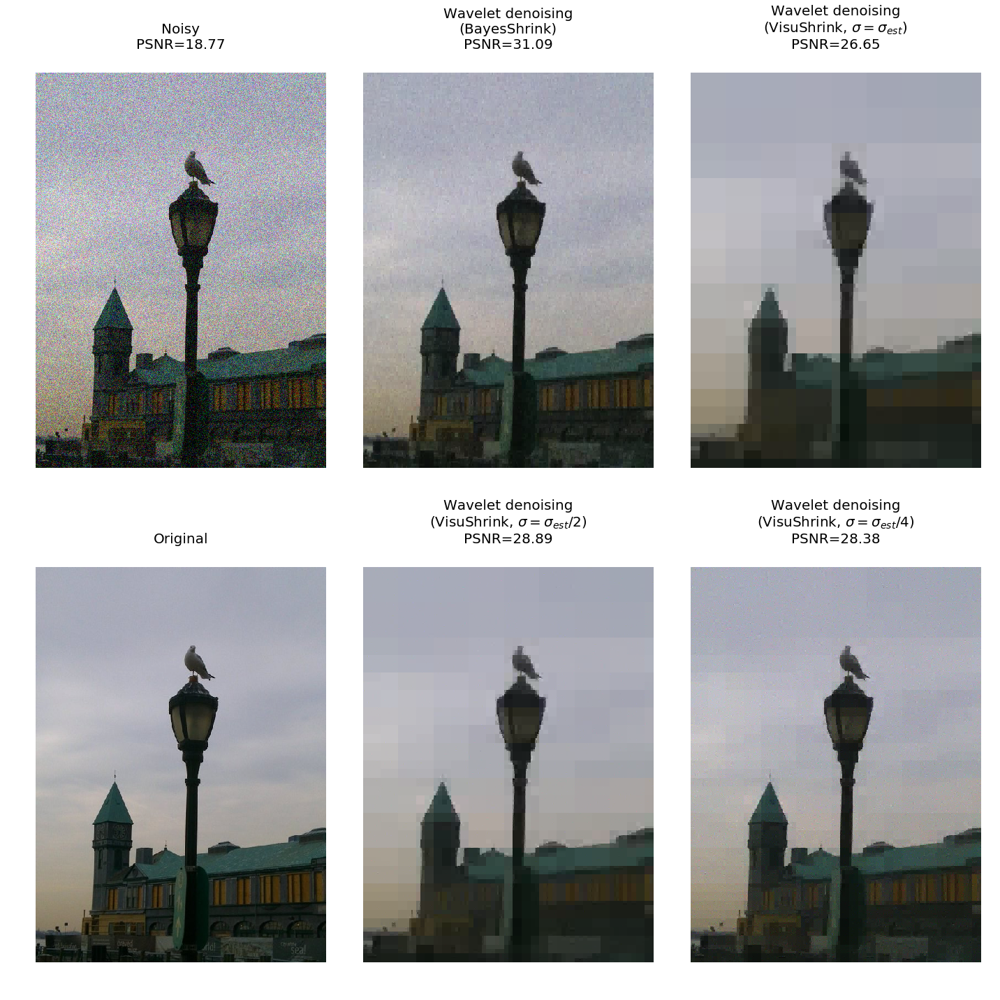

In [12]:
import matplotlib.pyplot as plt

from skimage.restoration import (denoise_wavelet, estimate_sigma)
from skimage import data, img_as_float
from skimage.util import random_noise
from skimage.measure import compare_psnr


original = img_as_float(imread('images/bird2.jpg'))

sigma = 0.12
noisy = random_noise(original, var=sigma**2)

fig, ax = plt.subplots(nrows=2, ncols=3, figsize=(20, 20), sharex=True, sharey=True)

plt.gray()

# Estimate the average noise standard deviation across color channels.
sigma_est = estimate_sigma(noisy, multichannel=True, average_sigmas=True)
# Due to clipping in random_noise, the estimate will be a bit smaller than the
# specified sigma.
print("Estimated Gaussian noise standard deviation = {}".format(sigma_est))

im_bayes = denoise_wavelet(noisy, multichannel=True, convert2ycbcr=True,
                           method='BayesShrink', mode='soft')

im_visushrink = denoise_wavelet(noisy, multichannel=True, convert2ycbcr=True,
                                method='VisuShrink', mode='soft',
                                sigma=sigma_est)

# VisuShrink is designed to eliminate noise with high probability, but this
# results in a visually over-smooth appearance.  Repeat, specifying a reduction
# in the threshold by factors of 2 and 4.
im_visushrink2 = denoise_wavelet(noisy, multichannel=True, convert2ycbcr=True,
                                 method='VisuShrink', mode='soft',
                                 sigma=sigma_est/2)
im_visushrink4 = denoise_wavelet(noisy, multichannel=True, convert2ycbcr=True,
                                 method='VisuShrink', mode='soft',
                                 sigma=sigma_est/4)

# Compute PSNR as an indication of image quality
psnr_noisy = compare_psnr(original, noisy)
psnr_bayes = compare_psnr(original, im_bayes)
psnr_visushrink = compare_psnr(original, im_visushrink)
psnr_visushrink2 = compare_psnr(original, im_visushrink2)
psnr_visushrink4 = compare_psnr(original, im_visushrink4)

ax[0, 0].imshow(noisy)
ax[0, 0].axis('off')
ax[0, 0].set_title('Noisy\nPSNR={:0.4g}'.format(psnr_noisy), size=20)
ax[0, 1].imshow(im_bayes)
ax[0, 1].axis('off')
ax[0, 1].set_title('Wavelet denoising\n(BayesShrink)\nPSNR={:0.4g}'.format(psnr_bayes), size=20)
ax[0, 2].imshow(im_visushrink)
ax[0, 2].axis('off')
ax[0, 2].set_title(('Wavelet denoising\n(VisuShrink, $\sigma=\sigma_{est}$)\n'
     'PSNR=%0.4g' % psnr_visushrink), size=20)
ax[1, 0].imshow(original)
ax[1, 0].axis('off')
ax[1, 0].set_title('Original', size=20)
ax[1, 1].imshow(im_visushrink2)
ax[1, 1].axis('off')
ax[1, 1].set_title(('Wavelet denoising\n(VisuShrink, $\sigma=\sigma_{est}/2$)\n'
     'PSNR=%0.4g' % psnr_visushrink2), size=20)
ax[1, 2].imshow(im_visushrink4)
ax[1, 2].axis('off')
ax[1, 2].set_title(('Wavelet denoising\n(VisuShrink, $\sigma=\sigma_{est}/4$)\n'
     'PSNR=%0.4g' % psnr_visushrink4), size=20)
fig.tight_layout()
#plt.savefig('images/wavelet_denoise_out.png', bbox_in='tight', pad_in=0)

plt.show()

### Mean Filter

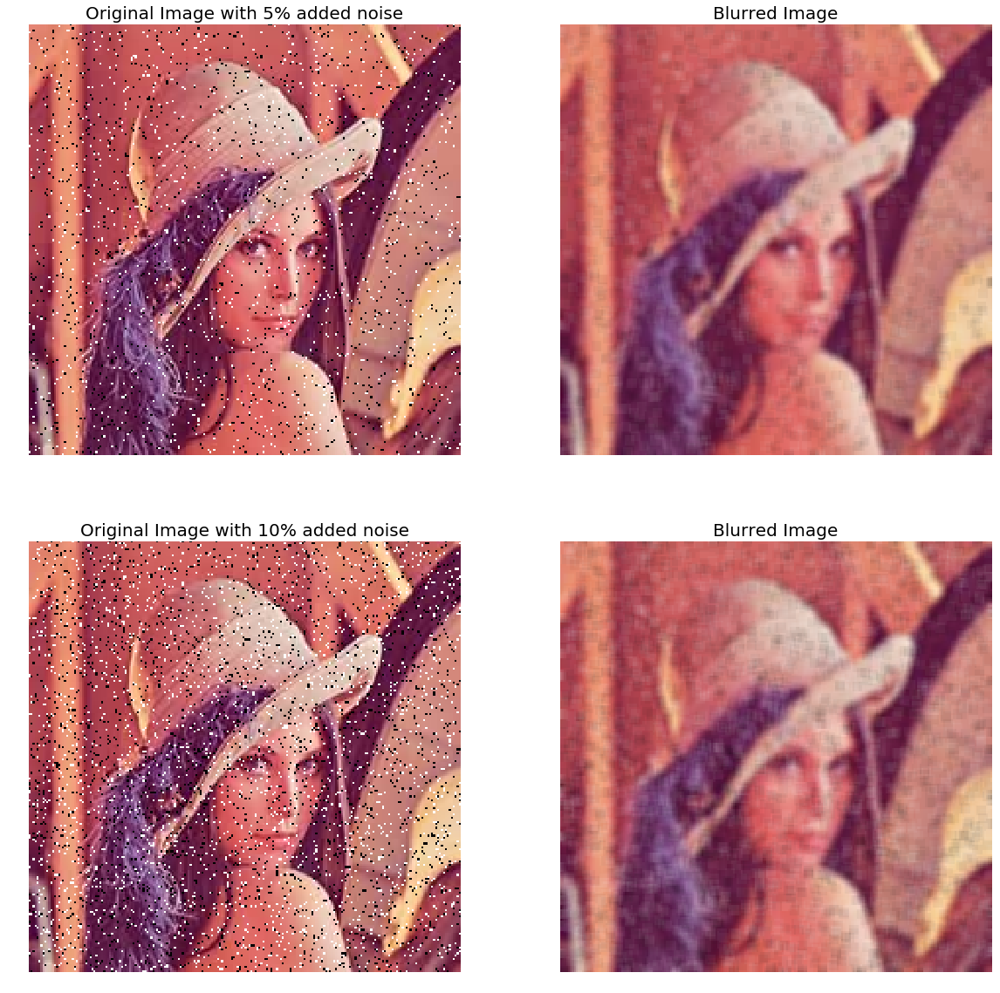

In [3]:
% matplotlib inline
import numpy as np
import matplotlib.pylab as plt
from PIL import Image, ImageFilter

i = 1
plt.figure(figsize=(20,20))
for prop_noise in [0.05, 0.1]:
 im = Image.open('images/lena.jpg')
 # choose random locations inside image
 n = int(im.width * im.height * prop_noise)
 x, y = np.random.randint(0, im.width, n), np.random.randint(0, im.height, n)
 for (x,y) in zip(x,y):
   im.putpixel((x, y), ((0,0,0) if np.random.rand() < 0.5 else (255,255,255))) # geenrate salt-and-pepper noise
 plt.subplot(2,2,i)
 plt.imshow(im)
 plt.title('Original Image with ' + str(int(100*prop_noise)) + '% added noise', size=20)
 plt.axis('off')
 i += 1
 im1 = im.filter(ImageFilter.BoxBlur(radius=2))
 plt.subplot(2,2,i) 
 plt.imshow(im1)
 plt.title('Blurred Image', size=20)
 plt.axis('off')
 i += 1

plt.show()

### Gaussian Filter

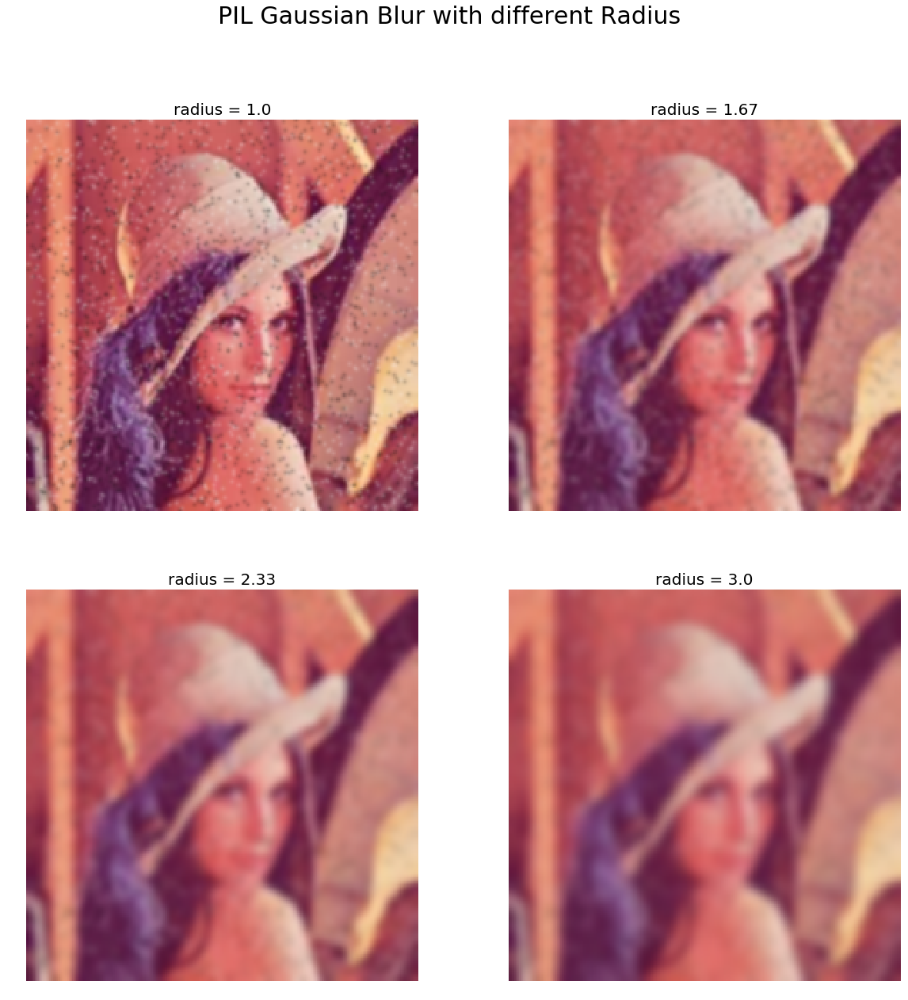

In [22]:
im = Image.open('images/lena.jpg')

prop_noise = 0.05
n = int(im.width * im.height * prop_noise)
x, y = np.random.randint(0, im.width, n), np.random.randint(0, im.height, n)
for (x,y) in zip(x,y):
  im.putpixel((x, y), ((0,0,0) if np.random.rand() < 0.5 else (255,255,255))) # geenrate salt-and-pepper noise

plt.figure(figsize=(20,20))
i = 1
for radius in np.linspace(1, 3, 4): 
    im1 = im.filter(ImageFilter.GaussianBlur(radius))
    plt.subplot(2,2,i)
    plt.imshow(im1)
    plt.title('radius = ' + str(round(radius,2)), size=20)
    plt.axis('off')
    i += 1
plt.suptitle('PIL Gaussian Blur with different Radius', size=30)
plt.show()

### Image Denoising with Markov Random Field

Completed 0 iterations out of 655360
Completed 100000 iterations out of 655360
Completed 200000 iterations out of 655360
Completed 300000 iterations out of 655360
Completed 400000 iterations out of 655360
Completed 500000 iterations out of 655360
Completed 600000 iterations out of 655360


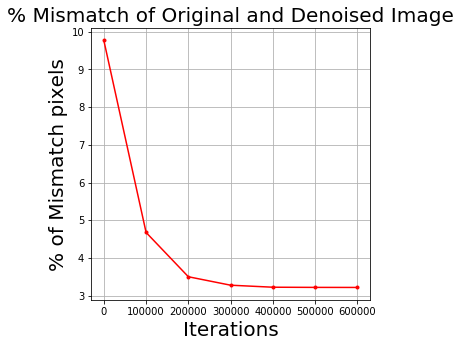

Percentage of mismatched pixels:  3.22265625


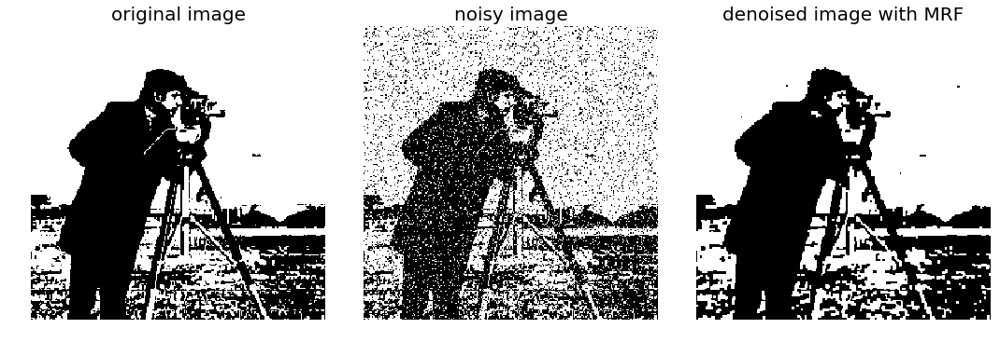

In [16]:
% matplotlib inline
import numpy as np
from PIL import Image
import sys
import matplotlib.pylab as plt

def plot_image(im, title):
  im = im.copy()
  im[im==-1] = 0
  im[im==1] = 255
  plt.imshow(im), plt.axis('off'), plt.title(title, size=20)

def plot_error(iters, errors):
    plt.figure(figsize=(5,5))
    plt.plot(iters, errors, 'r.-')
    plt.xlabel('Iterations', size=20)
    plt.ylabel('% of Mismatch pixels', size=20)
    plt.title('% Mismatch of Original and Denoised Image', size=20)
    plt.grid()
    plt.show()

def plot_images(orig_image, noisy_image, denoised_image):
    plt.figure(figsize=(15,5))
    plt.gray()
    plt.subplot(131), plot_image(orig_image, 'original image')
    plt.subplot(132), plot_image(noisy_image, 'noisy image')
    plt.subplot(133), plot_image(denoised_image, 'denoised image with MRF')
    plt.tight_layout()
    plt.show()

def compute_log_prob_helper(Y, i, j):
  try:
    return Y[i][j]
  except IndexError:
    return 0

def compute_log_prob(X, Y, i, j, w_e, w_s, y_val):
  log_prob = w_e * X[i][j] * y_val
  log_prob += w_s * y_val * compute_log_prob_helper(Y, i-1, j)
  log_prob += w_s * y_val * compute_log_prob_helper(Y, i+1, j)
  log_prob += w_s * y_val * compute_log_prob_helper(Y, i, j-1)
  log_prob += w_s * y_val * compute_log_prob_helper(Y, i, j+1)
  return log_prob

def denoise_image(O, X, w_e, w_s):
  m, n = np.shape(X)
  Y = np.copy(X)
  max_iter = 10*m*n
  iters = []
  errors = []
  for iter in range(max_iter):
    # randomly pick a location
    i = np.random.randint(m)
    j = np.random.randint(n)
    # compute the log probabilities of both values of Y_ij
    #log_p_neg = compute_log_prob(X, Y, i, j, w_e, w_s, -1)
    log_p_pos = compute_log_prob(X, Y, i, j, w_e, w_s, 1)
    # assign Y_ij to the value with higher log probability
    #if log_p_neg > log_p_pos:
    if np.random.uniform(0, 1, 1) > log_p_pos:
      Y[i][j] = -1
    else:
      Y[i][j] = 1
    if iter % 100000 == 0:
      print ('Completed', iter, 'iterations out of', max_iter)
      error = get_mismatched_percentage(O, Y)
      iters.append(iter)
      errors.append(error)
        
  plot_error(iters, errors)
  
  return Y

# preprocessing step
def read_image_and_binarize(image_file):
  im = Image.open(image_file).convert("L")
  im = np.asarray(im).astype(int)
  im[im < 128] = -1
  im[im >= 128] = 1
  return im

def add_noise(im):
  im_noisy = im.copy()
  for i in range(np.size(im_noisy, 0)):
    for j in range(np.size(im_noisy, 1)):
      r = np.random.rand()
      if r < 0.1:
        im_noisy[i][j] = -im_noisy[i][j]
  return im_noisy

def get_mismatched_percentage(orig_image, denoised_image):
  diff = abs(orig_image - denoised_image) / 2
  return (100.0 * np.sum(diff)) / np.size(orig_image)

orig_image = read_image_and_binarize('images/cameraman.jpg')
w_e = 8
w_s = 10

# add noise
noisy_image = add_noise(orig_image)

# use ICM for denoising
denoised_image = denoise_image(orig_image, noisy_image, w_e, w_s)

# print the percentage of mismatched pixels
print ('Percentage of mismatched pixels: ', get_mismatched_percentage(orig_image, denoised_image))

plot_images(orig_image, noisy_image, denoised_image)

### Distributed Image Processing with Dask

pygame 1.9.4
Hello from the pygame community. https://www.pygame.org/contribute.html


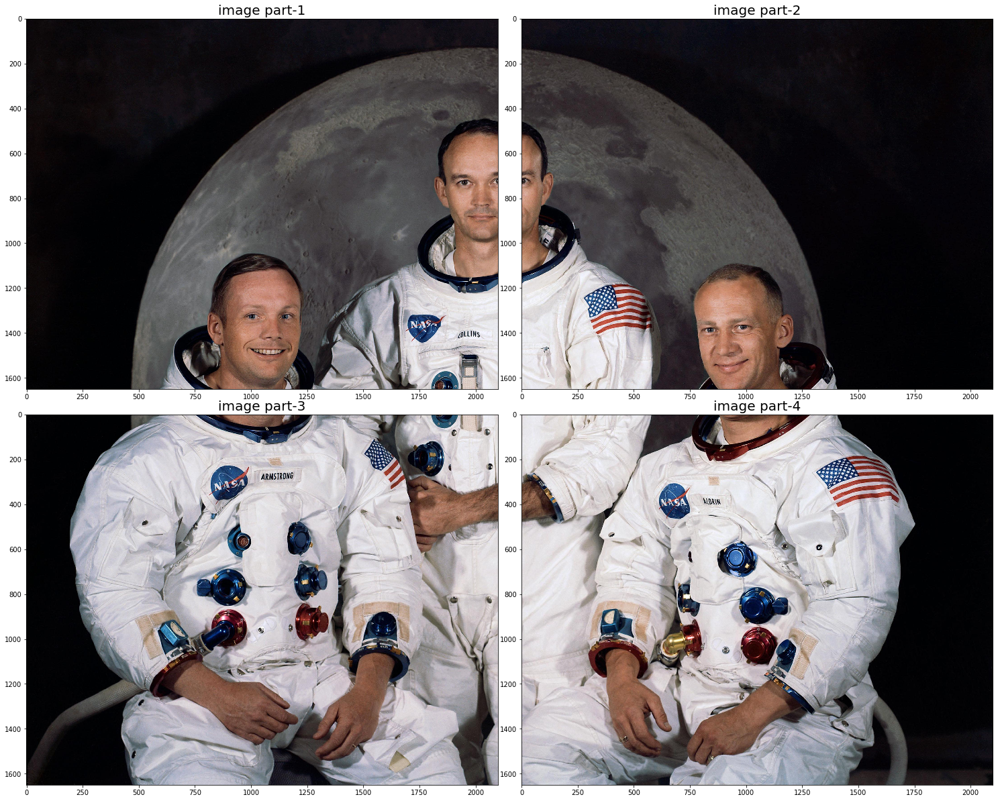

(3300, 4200)


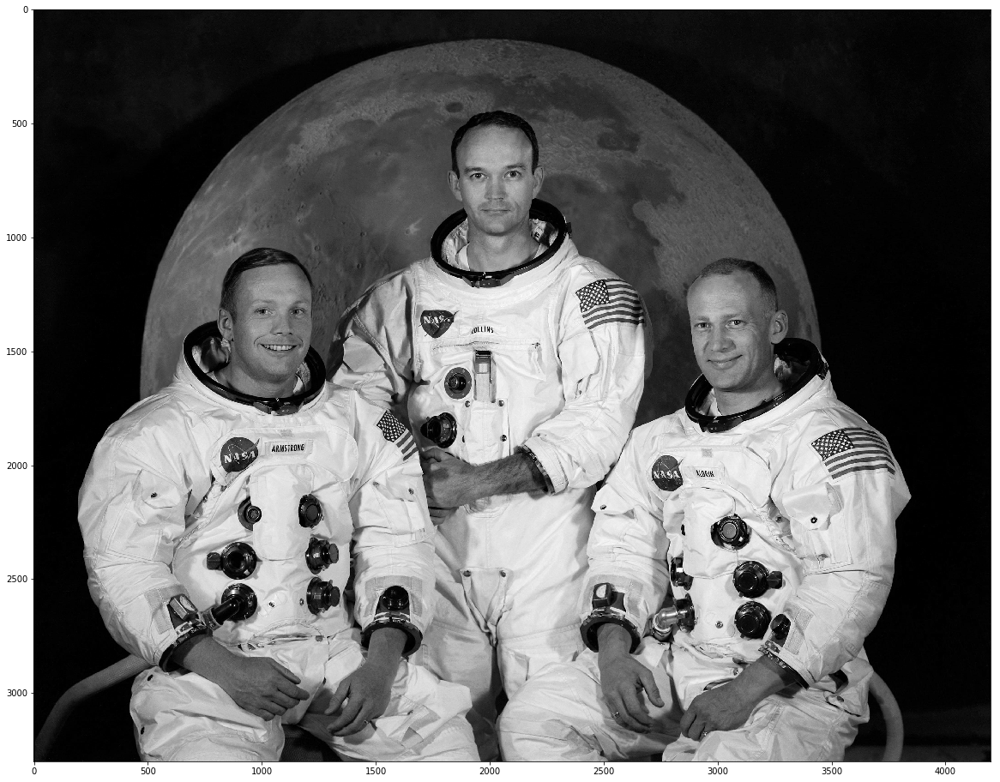

dask.array<_trim, shape=(3300, 4200), dtype=float64, chunksize=(1650, 2100)>


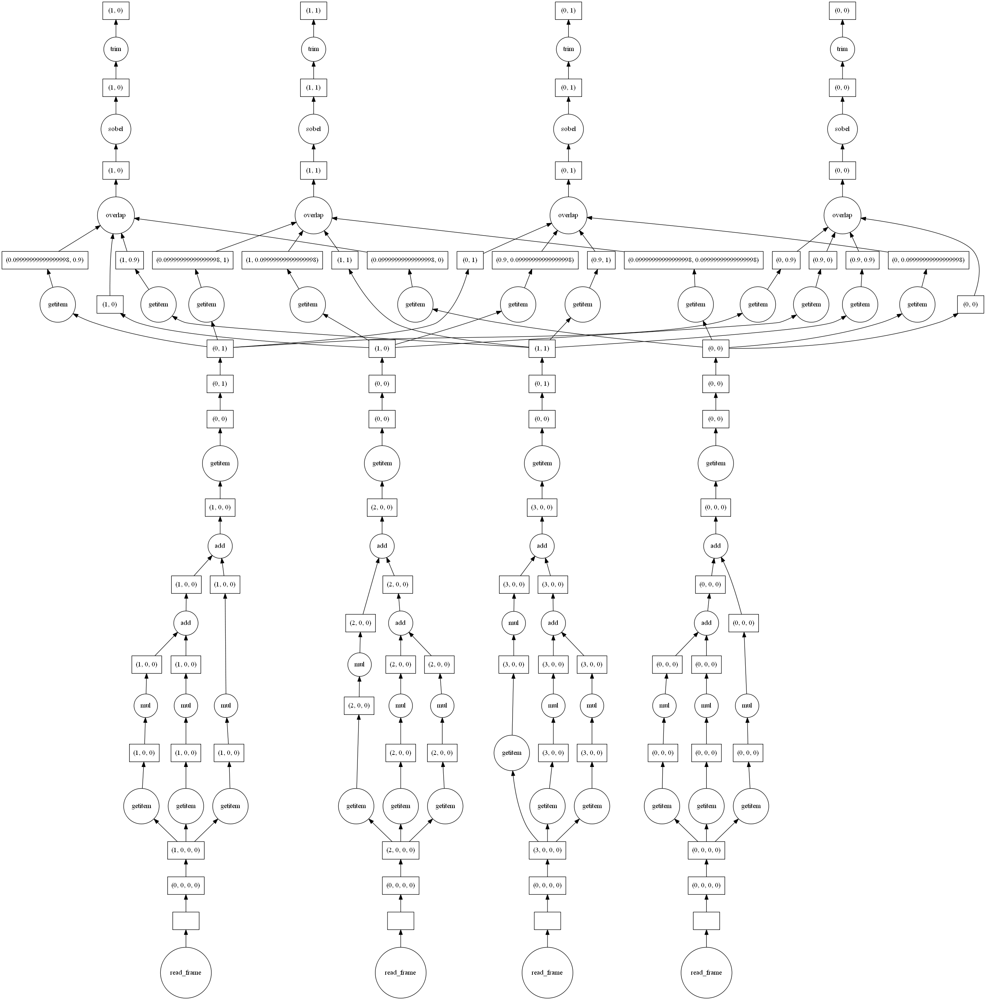

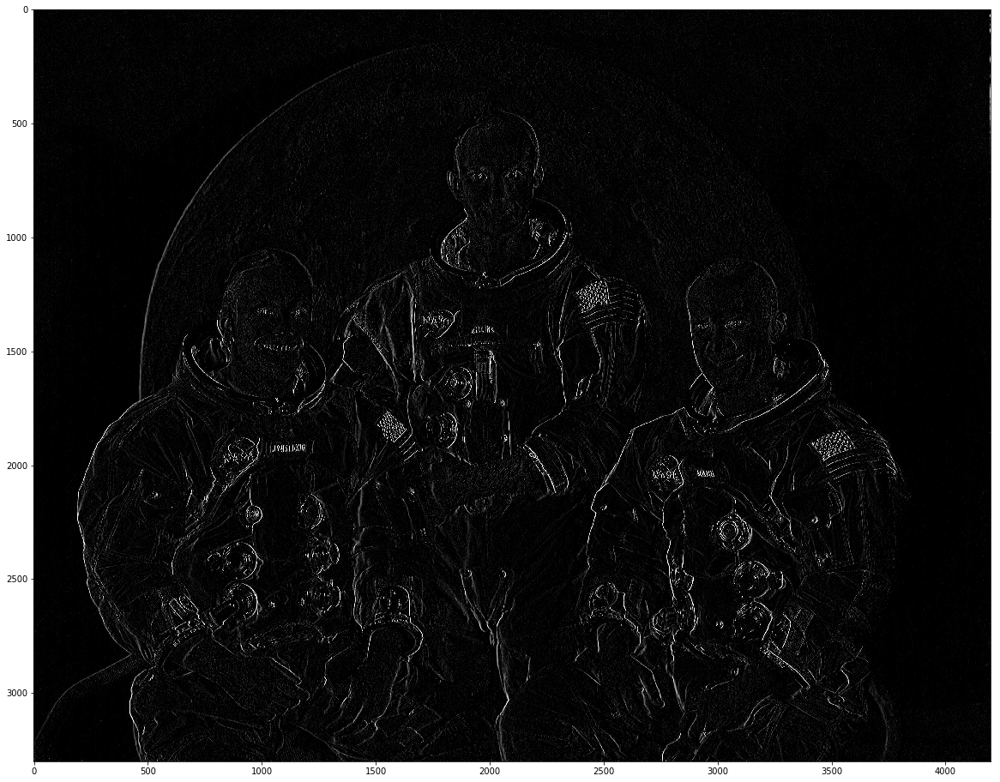

In [10]:
from skimage.io import imread, imsave
import numpy as np
import matplotlib.pylab as plt
import dask_image.imread
import dask.array
import dask_image.ndfilters
import os, glob
from IPython.display import display

def rgb2gray(rgb):
    result = ((rgb[..., 0] * 0.2125) +
              (rgb[..., 1] * 0.7154) +
              (rgb[..., 2] * 0.0721))
    return result

def partion_image(imgfile, n_h=2, n_w=2, plot=True):
    im = imread(imgfile)
    h, w, _ = im.shape
    h_s, w_s = h // n_h, w // n_w
    k = 0
    for i in range(n_h):
        for j in range(n_w):
            imsave(imgfile[:-4] + '_part_{:03d}'.format(k) + imgfile[-4:], im[i*h_s:(i+1)*h_s, j*w_s:(j+1)*w_s, :])          
            k += 1
    if plot:
        k = 0
        plt.figure(figsize=(20,16))
        plt.subplots_adjust(0,0,1,1,0.05,0.05)
        for i in range(n_h):
            for j in range(n_w):
                im = plt.imread(imgfile[:-4] + '_part_{:03d}'.format(k) + imgfile[-4:])
                plt.subplot(n_h, n_w, k+1), plt.imshow(im), plt.title('image part-{}'.format(k+1), size=20)
                k += 1
        plt.show()
   
def partition_compute_edge_combine(imgfile, n_h=2, n_w=2, n_c=3):
    partion_image(imgfile)
    filename_pattern = os.path.join('./', imgfile[:-4] + '_part_*' + imgfile[-4:])
    partitioned_images = dask_image.imread.imread(filename_pattern)
    result  = rgb2gray(partitioned_images) 
    data = [result[i, ...] for i in range(result.shape[0])]
    data = [data[i:i+n_w] for i in range(0, len(data), n_w)]
    combined_image = dask.array.block(data)
    print(combined_image.shape)
    plt.figure(figsize=(20,20))
    plt.imshow(combined_image, cmap='gray')
    plt.show()
    edges = dask_image.ndfilters.sobel(combined_image)
    print(edges)
    display(edges.visualize())
    edges = np.clip(edges, 0, 255)
    plt.figure(figsize=(20,20))
    plt.imshow(edges, cmap='gray')
    plt.show()
    
partition_compute_edge_combine('images/apolo.jpg')